<div class="usecase-title"><h2><b>Enhancing Urban Tree Planting through Air Quality Analysis</b></h2></div>

<div class="usecase-authors"><b>Authored by: </b> Vamshi Krishna Y R</div>

<div class="usecase-duration"><b>Duration:</b> 90 mins</div>

<div class="usecase-level-skill">
    <div class="usecase-level"><b>Level: </b>Intermediate</div>
    <div class="usecase-skill"><b>Pre-requisite Skills: </b>Python, Pandas, Matplotlib, Folium, Geopandas, Plotly, Scikit-learn</div>
</div>

<div class="usecase-section-header"><h3><b>Use case scenario</b></h3></div>

**As a:** Resident of Melbourne who values sustainable city living and concerned about air pollution and its impact on daily health and wellbeing.<br>

**I want to:** See key roadside areas in the city selected for tree planting projects based on their potential to reduce airborne pollutants.<br>

**So that I can:** Breathe cleaner air in urban spaces, benefiting from reduced exposure to traffic-related emissions and a healthier living environment.<br>

**By:**

- Analysing microclimate sensor data to identify areas along Melbourne’s roadways with poor air quality and high exposure to vehicular emissions.
  
- Mapping these pollution-prone zones against existing tree canopy data to locate streets with minimal natural filtration and shade coverage.

- Integrating tree planting zone data to pinpoint feasible locations for vegetation expansion that align with municipal greening regulations and infrastructure constraints.

- Selecting tree species with high pollutant absorption capabilities and modelling their expected impact on local air quality over time.

- Applying geospatial analysis to overlay environmental indicators—such as pollutant levels, canopy gaps, and permissible planting areas—to inform strategic decision-making.


<div class="usecase-section-header"><h3><b>What this use case will teach you</b></h3></div>

- This use case explores how to integrate diverse urban datasets—specifically microclimate sensor readings, tree canopy coverage, and planting zone data—to identify roadside locations where strategic tree planting can significantly improve air quality. By engaging with real-world environmental data, you will address pressing urban health challenges related to pollution exposure.

- You will gain practical experience in applying geospatial analysis and leveraging microclimate insights to support data-informed decisions in sustainable urban planning.

- The case study focuses on techniques for assessing how vegetation coverage, pollutant concentrations, and permissible planting zones intersect, equipping you with the tools to prioritise greening interventions that deliver measurable air quality benefits.

- A key learning outcome will be the development of user-friendly dashboards and interactive visualisations to effectively communicate findings to stakeholders such as urban planners, environmental agencies, and community members.

- You will also learn to evaluate the environmental and societal implications of targeted greening projects, enabling you to propose data-driven strategies for creating healthier, more breathable urban environments.


<div class="usecase-section-header"><h3><b>Project Goals and expected outcomes</b></h3></div>

- This project showcases the capability to integrate and analyse multiple open datasets—specifically microclimate sensor data, existing tree canopy coverage, and designated planting zones—to identify roadside locations where new tree plantings can most effectively improve urban air quality.

- The analysis will involve spatial and environmental evaluations to prioritise streets and road corridors that currently experience high levels of air pollution and lack sufficient vegetation. These assessments will guide decisions around optimal placement and species selection to maximise air filtration benefits.

- The goal is to deliver actionable insights that contribute to cleaner urban air by enhancing tree coverage in strategically selected areas. The project supports Melbourne’s broader objectives for sustainability, public health, and environmental resilience.

- A central output will be the development of an interactive, user-focused dashboard that visualises pollutant levels, canopy gaps, and suitable planting zones. This tool will empower urban planners, environmental stakeholders, and policymakers to make data-informed decisions.

- Ultimately, the project aims to provide clear, evidence-based recommendations for improving air quality through targeted urban greening—enhancing both the environmental performance of city streets and the everyday wellbeing of Melbourne’s residents.


## Initialisation

#### Importing the necessary libraries

In [1]:
import warnings
warnings.filterwarnings("ignore")
# Enable inline plotting in Jupyter notebooks
%matplotlib inline

# Data handling
import pandas as pd                   # Data manipulation (e.g. reading CSVs, merging sensor & API data)
import numpy as np                    # Numerical operations (e.g. statistics, array maths)
import math                           # Maths functions (e.g. sqrt for computing buffer radii)
import json                           # Parse JSON responses from Open Meteo or other APIs
from io import StringIO               # In-memory text I/O (e.g. loading CSV data from a string)

# Geospatial processing
import geopandas as gpd               # GeoDataFrames for shapefiles & GeoJSON
from shapely.geometry import Point, shape  # Create/manipulate geometric objects (sensor points, canopy polygons)
from geopy.distance import geodesic   # Calculate great-circle distances (e.g. Haversine formula for 50 m radius)

# Static & interactive mapping
import contextily as ctx              # Basemap tiles for GeoPandas plots (e.g. OSM background)
import folium                         # Interactive leaflet maps in Jupyter (e.g. pan/zoom sensor coverage)

# Visualisation
import matplotlib.pyplot as plt       # Static charts (e.g. bar plots, heatmaps)
import seaborn as sns                 # Statistical viz (e.g. correlation matrix heatmap)
import plotly.express as px           # Interactive plots (e.g. time-series of PM₂.₅)

# HTTP requests with caching & retries
import requests                       # API calls (e.g. fetch tree-canopy GeoJSON)
import requests_cache                 # Cache API responses (avoid repeated rate limits)
from retry_requests import retry      # Retry logic (e.g. for transient network errors)
import openmeteo_requests             # Client for Open Meteo weather & air-pollution API

# Notebook display helpers
from IPython.display import IFrame    # Embed HTML (e.g. folium maps) directly in cells

# Utility data structures
from collections import defaultdict   # Default dictionaries (e.g. grouping counts by schedule)

# Machine learning pipeline
from sklearn.pipeline import Pipeline           # Chain preprocessing & model steps
from sklearn.impute import SimpleImputer       # Handle missing values (e.g. fill NaNs in PM₂.₅)
from sklearn.preprocessing import OneHotEncoder# Encode categorical features (e.g. month → dummy vars)
from sklearn.ensemble import RandomForestRegressor  # Bagging-based ensemble regressor
from xgboost import XGBRegressor               # Gradient-boosting regressor
from sklearn.model_selection import RandomizedSearchCV, GroupKFold  # Hyperparameter search & grouped CV
from sklearn.metrics import mean_squared_error, r2_score  # Evaluation metrics (e.g. RMSE, R²)
import joblib                                  # Save/load trained models (e.g. persist best model)

#### Importing the data through API from open data portal of Melbourne

The below function accesses open datasets via API endpoints, enabling users to obtain information in CSV format suitable for in-depth analysis. By providing the dataset identifier and a valid API key, it issues a request to the Melbourne data portal and interprets the response to retrieve pertinent data. This method streamlines the incorporation of diverse datasets—such as microclimate sensor, urban tree canopies, and tree planting zone, facilitating straightforward access and efficient data integration for applications in urban planning research.

In [ ]:
def import_data(datasetname): # pass in dataset name and api key

    """
    Imports a dataset from the City of Melbourne Open Data API.

    Parameters:
    - dataset_id (str): The unique dataset identifier.
    Returns:
    - pd.DataFrame: The imported dataset as a pandas DataFrame.
    """

    dataset_id = datasetname

    base_url = 'https://data.melbourne.vic.gov.au/api/explore/v2.1/catalog/datasets/'
    apikey = '<Your API Key>'
    dataset_id = dataset_id
    format = 'csv'

    url = f'{base_url}{dataset_id}/exports/{format}'
    params = {
        'select': '*',
        'limit': -1,  # all records
        'lang': 'en',
        'timezone': 'UTC'
    }

    # GET request
    response = requests.get(url, params=params)

    if response.status_code == 200:
        # StringIO to read the CSV data
        url_content = response.content.decode('utf-8')
        datasetname = pd.read_csv(StringIO(url_content), delimiter=';')
        print(f' Imported the {dataset_id} dataset with {len(datasetname)} records succesfully \n')
        return datasetname 
    else:
        return (print(f'Request failed with status code {response.status_code}'))


### Datasets

The following section illustrates how data is retrieved and prepared for analysis using multiple datasets. The import_data function is employed to access three key datasets: tree canopies, microclimate sensors, and tree planting zones. Each dataset is stored in separate pandas dataframe — tree_canopy_2021, microclimate, and tree_planting. The number of records retrieved from each dataset is displayed, providing a clear overview of the data volume available for exploration. This structured approach ensures that the datasets are properly organized and readily available for integration into analytical workflows within the project.

**Importing dataset - tree-canopies-2021-urban-forest**

**About the dataset:** The Tree Canopies 2021 - Urban Forest dataset maps the extent of tree canopy cover across the City of Melbourne using aerial imagery and LiDAR data. It provides detailed spatial insights into urban forest coverage, supporting initiatives in climate resilience, biodiversity, and urban planning.

In [3]:
tree_canopy_2021 = 'tree-canopies-2021-urban-forest' 
df_tree_canopy_2021 = import_data(tree_canopy_2021)
df_tree_canopy_2021.to_csv('df_tree_canopy_2021.csv', index=False) # saving into a local file
df_tree_canopy_2021_orig = df_tree_canopy_2021 #saving the original dataset
print('First few rows of the dataset:\n',df_tree_canopy_2021.head(5))

 Imported the tree-canopies-2021-urban-forest dataset with 57980 records succesfully 

First few rows of the dataset:
                               geo_point_2d  \
0   -37.77506304683423, 144.93898465421296   
1  -37.775132956993566, 144.93979253397976   
2   -37.77515941768105, 144.93986878938023   
3   -37.775130649990984, 144.9389679196713   
4   -37.77518700935825, 144.93875479828375   

                                           geo_shape  
0  {"coordinates": [[[[144.9389624164712, -37.775...  
1  {"coordinates": [[[[144.93978541786475, -37.77...  
2  {"coordinates": [[[[144.93986368038625, -37.77...  
3  {"coordinates": [[[[144.93894119058956, -37.77...  
4  {"coordinates": [[[[144.93877858274755, -37.77...  


--------------------------------------------------------------------------------------------------------------------

**Importing dataset - microclimate-sensors-data**

**About the dataset:** The Microclimate Sensors Data dataset captures real-time environmental conditions across Melbourne using a network of sensors. It includes measurements such as air temperature, humidity, and solar radiation, supporting research in urban heat islands, climate monitoring, and sustainable city planning.

In [4]:
microclimate = 'microclimate-sensors-data' 
df_microclimate = import_data(microclimate)
df_microclimate.to_csv('df_microclimate.csv', index=False) # saving into a local file
df_microclimate_orig = df_microclimate #saving the original dataset
print('First few rows of the dataset:\n',df_microclimate.head(5))

 Imported the microclimate-sensors-data dataset with 334847 records succesfully 

First few rows of the dataset:
             device_id                received_at  \
0  ICTMicroclimate-08  2025-02-09T00:54:37+00:00   
1  ICTMicroclimate-11  2025-02-09T01:02:11+00:00   
2  ICTMicroclimate-05  2025-02-09T01:03:24+00:00   
3  ICTMicroclimate-01  2025-02-09T01:02:43+00:00   
4  ICTMicroclimate-09  2025-02-09T01:17:37+00:00   

                                      sensorlocation  \
0  Swanston St - Tram Stop 13 adjacent Federation...   
1                                   1 Treasury Place   
2                 Enterprize Park - Pole ID: COM1667   
3                    Birrarung Marr Park - Pole 1131   
4  SkyFarm (Jeff's Shed). Rooftop - Melbourne Con...   

                    latlong  minimumwinddirection  averagewinddirection  \
0  -37.8184515, 144.9678474                   0.0                 153.0   
1   -37.812888, 144.9750857                   0.0                 144.0   
2  -37.8204

--------------------------------------------------------------------------------------------------------------------

**Determining the microclimate time‐span**

Convert `received_at` to datetime, then compute and print:
- `df_microclimate_min_date` – earliest date  

- `df_microclimate_max_date` – latest date  

These two variables define the exact period used in the following cell to fetch matching PM2.5, temperature and humidity data from the Open Meteo API.


In [5]:
# making sure the column is in datetime format
df_microclimate['received_at'] = pd.to_datetime(df_microclimate['received_at'])

# finding the earliest (min) and latest (max) timestamp
df_microclimate_min_date = df_microclimate['received_at'].min().date()
df_microclimate_max_date = df_microclimate['received_at'].max().date()

# printing the results
print(f"Earliest timestamp in dataset: {df_microclimate_min_date}")
print(f"Latest timestamp in dataset: {df_microclimate_max_date}")

Earliest timestamp in dataset: 2024-05-29
Latest timestamp in dataset: 2025-05-15


**Complementing Microclimate Data with Open Meteo API**

To effectively analyse the impact of tree planting on air quality, comprehensive environmental data is essential. While the microclimate sensors provide valuable localised measurements, we need to supplement this with consistent historical data across the entire study area. Open Meteo serves as an ideal source for this supplementary data for several reasons:

1. **Complete PM2.5 Coverage**: Open Meteo provides consistent PM2.5 measurements across Melbourne, helping to identify the impact of tree canopy on pm2.5 when compared against the sensor network and ensuring comprehensive pollution analysis at potential tree planting sites.

2. **Weather Variable Correlation**: Research shows that PM2.5 concentrations are influenced by temperature and humidity. By obtaining these variables from Open Meteo, we can establish relationships between environmental conditions and pollution levels.

3. **Historical Data Access**: The API allows us to match the exact timeframe of our microclimate dataset (`df_microclimate_min_date` to `df_microclimate_max_date`), ensuring temporal alignment in our analysis.

4. **Spatial Resolution**: Data can be requested for specific latitude/longitude coordinates, enabling precise environmental assessment at each proposed tree planting location.

This additional data will strengthen our ability to model the potential air quality improvements from strategic tree planting, providing evidence-based recommendations for urban forest expansion.

In [6]:
def fetch_from_open_meteo(url, fetch_col, start_date, end_date, latitude = 37.814, longitude = 144.9633):
    '''
    Fetches weather data from Open Meteo API.
    Parameters:
    - url (str): The API endpoint URL.
    - fetch_col (str): The specific weather variable to fetch.
    - start_date (str): The start date for the data retrieval in 'YYYY-MM-DD' format.
    - end_date (str): The end date for the data retrieval in 'YYYY-MM-DD' format.
    - latitude (float): Latitude of the location. Default is Melbourne's latitude.
    - longitude (float): Longitude of the location. Default is Melbourne's longitude.
    Returns:
    - pd.DataFrame: A DataFrame containing the fetched weather data.
    '''

    # setting up caching + retries
    cache_session = requests_cache.CachedSession('.cache', expire_after = 3600)
    retry_session = retry(cache_session, retries = 5, backoff_factor = 0.2)
    openmeteo = openmeteo_requests.Client(session = retry_session)
        
    params = {
        "latitude": latitude,
        "longitude": longitude,
        "hourly":fetch_col ,
        "timezone": "Australia/Sydney",
        "start_date": start_date,
        "end_date": end_date
    }
    response = openmeteo.weather_api(url, params)[0]
    hourly = response.Hourly()
    dates = pd.date_range(
        start = pd.to_datetime(hourly.Time(), unit="s", utc=True),
        end = pd.to_datetime(hourly.TimeEnd(), unit="s", utc=True),
        freq = pd.Timedelta(seconds=hourly.Interval()),
        inclusive = "left"
    )
    df_fetch = pd.DataFrame({
        "date": dates,
        fetch_col: hourly.Variables(0).ValuesAsNumpy()
    })
    #dropping rows with missing values
    df_fetch = df_fetch.dropna(subset=[fetch_col])

    return df_fetch


In [7]:
# setting the parameters for the API call
air_quality_url = "https://air-quality-api.open-meteo.com/v1/air-quality" # for pm25 historical data
air_fetch_col = "pm2_5"

temp_url = "https://archive-api.open-meteo.com/v1/archive" # for temperature & humidity historical data
temp_fetch_col = "temperature_2m"
rhum_fetch_col = "relative_humidity_2m"

In [8]:
# fetching air quality data to completement the microclimate dataset
df_air = fetch_from_open_meteo(air_quality_url, air_fetch_col, df_microclimate_min_date, df_microclimate_max_date)
print("df_air:",len(df_air))
print(f"Null pm2_5 values: {df_air['pm2_5'].isna().sum()}")

# fetching temperature data to completement the microclimate dataset
df_temp = fetch_from_open_meteo(temp_url, temp_fetch_col, df_microclimate_min_date, df_microclimate_max_date)
print("df_temp:",len(df_temp))
print(f"Null temperature_2m values: {df_temp['temperature_2m'].isna().sum()}")

# fetching relative humidity data to completement the microclimate dataset
df_rhum = fetch_from_open_meteo(temp_url, rhum_fetch_col, df_microclimate_min_date, df_microclimate_max_date)
print("df_rhum:",len(df_rhum))
print(f"Null relative_humidity_2m values: {df_rhum['relative_humidity_2m'].isna().sum()}")

df_air: 8448
Null pm2_5 values: 0
df_temp: 8411
Null temperature_2m values: 0
df_rhum: 8411
Null relative_humidity_2m values: 0


**Importing dataset - Tree Planting Zone schedule**

**About the dataset:** The Tree Planting Zone Schedules with Years - Urban Forest dataset outlines planned and completed tree planting activities across various city zones from 2017 onward. It provides scheduling information to support long-term urban greening strategies and enhance canopy coverage in the City of Melbourne.

In [9]:
tree_planting = 'tree-planting-zone-schedules-with-years-urban-forest'
df_tree_planting = import_data(tree_planting)
df_tree_planting.to_csv('df_tree_planting.csv', index=False) # saving into a local file
df_tree_planting_orig = df_tree_planting #saving the original dataset
print('First few rows of the dataset:\n',df_tree_planting.head(5))

 Imported the tree-planting-zone-schedules-with-years-urban-forest dataset with 839 records succesfully 

First few rows of the dataset:
                               geo_point_2d  \
0    -37.8030612625994, 144.96879535330316   
1    -37.81979235869452, 144.9675112730786   
2  -37.796602429685905, 144.96990674715127   
3    -37.79774465832566, 144.9502620746376   
4    -37.81652483951976, 144.9864951838192   

                                           geo_shape  str_from  segpart  \
0  {"coordinates": [[[[144.969387175266, -37.8029...       NaN      NaN   
1  {"coordinates": [[[[144.96828098035, -37.81969...       NaN      NaN   
2  {"coordinates": [[[[144.969341164027, -37.7965...       NaN      NaN   
3  {"coordinates": [[[[144.950283591209, -37.7975...       NaN      NaN   
4  {"coordinates": [[[[144.986101797552, -37.8163...       NaN      NaN   

   statusid  segid  streetname  streetid                         schedule  \
0       NaN  21556         NaN       NaN  Not determined 

## Data Cleansing and Preprocessing

The Data Cleansing and preprocessing phase focuses on preparing the tree canopies, microclimate sensors, and tree planting zones datasets for analysis. This involves resolving inconsistencies, handling missing entries, and reformatting data as needed—such as separating latitude and longitude fields, removing redundant columns, and ensuring appropriate structure across datasets. These steps are critical to harmonize the datasets for seamless integration and analysis. By standardizing and validating the data, this process enhances the accuracy and reliability of any insights derived.

In [10]:
def split_geo_coordinates(df, geo_column):
    """
    Splits a combined latitude,longitude column into two separate float columns: 'latitude' and 'longitude'.
    
    Parameters:
    - df (pd.DataFrame): The input DataFrame containing the geo column.
    - geo_column (str): The name of the column with 'latitude,longitude' string values.

    Returns:
    - pd.DataFrame: A new DataFrame with separate 'latitude' and 'longitude' columns.
    """
    if geo_column not in df.columns:
        raise ValueError(f"Column '{geo_column}' not found in DataFrame.")

    try:
        # Ensure the geo_column is of string type
        df[geo_column] = df[geo_column].astype(str)

        # Attempt to split the column
        split_data = df[geo_column].str.split(',', expand=True)

        if split_data.shape[1] != 2:
            raise ValueError(f"Column '{geo_column}' does not contain valid 'latitude,longitude' format.")

        df['latitude'] = pd.to_numeric(split_data[0], errors='coerce')
        df['longitude'] = pd.to_numeric(split_data[1], errors='coerce')

        # Drop rows with invalid coordinates
        df.dropna(subset=['latitude', 'longitude'], inplace=True)

        # Drop the original geo column
        df = df.drop(columns=[geo_column])

        print('Dataset Info after Geo Split:\n')
        print(df.info())

    except Exception as e:
        print(f"An error occurred during geolocation splitting: {e}")
        raise

    return df

In [11]:
def check_preprocess_dataset(df_dataset, dataset_name='dataset'):
    """
    Inspects and preprocesses a dataset:
    - Prints dataset info
    - Checks for missing values
    - Removes duplicate rows (if any)

    Parameters:
    - df_dataset (pd.DataFrame): The input DataFrame to be checked and cleaned.
    - dataset_name (str): Optional name of the dataset for logging purposes.

    Returns:
    - pd.DataFrame: A cleaned version of the input DataFrame.
    """
    try:
        if not isinstance(df_dataset, pd.DataFrame):
            raise TypeError("Input is not a pandas DataFrame.")

        print(f'Dataset Information for "{dataset_name}":\n')
        print(df_dataset.info())

        # Check for missing values
        print(f'\nMissing values in "{dataset_name}" dataset:\n')
        print(df_dataset.isnull().sum())

        # Identify and remove duplicates
        dupes = df_dataset.duplicated().sum()
        if dupes > 0:
            df_dataset = df_dataset.drop_duplicates()
            print(f'\nDeleted {dupes} duplicate record(s) from "{dataset_name}".')
        else:
            print(f'\nNo duplicate records found in "{dataset_name}".')

    except Exception as e:
        print(f"An error occurred while preprocessing '{dataset_name}': {e}")
        raise

    return df_dataset


<b>Tree Canopies 2021 dataset</b>

In [12]:
df_tree_canopy_2021 = check_preprocess_dataset(df_tree_canopy_2021, 'Tree Canopies 2021')

Dataset Information for "Tree Canopies 2021":

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 57980 entries, 0 to 57979
Data columns (total 2 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   geo_point_2d  57980 non-null  object
 1   geo_shape     57980 non-null  object
dtypes: object(2)
memory usage: 906.1+ KB
None

Missing values in "Tree Canopies 2021" dataset:

geo_point_2d    0
geo_shape       0
dtype: int64

No duplicate records found in "Tree Canopies 2021".


To facilitate spatial analysis, the `geo_point_2d` column was split into separate `latitude` and `longitude` columns. These new columns were then converted into numeric formats to allow for further computations and visualisations. Finally, the original `geo_point_2d` column was dropped to avoid redundancy, leaving a clean and structured dataset ready for spatial analysis and modeling.

In [13]:
#splitting geo coordinates
df_tree_canopy_2021 = split_geo_coordinates(df_tree_canopy_2021,'geo_point_2d')
print('First few rows of the dataset after preprocessing:\n',df_tree_canopy_2021.head(5))

Dataset Info after Geo Split:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 57980 entries, 0 to 57979
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   geo_shape  57980 non-null  object 
 1   latitude   57980 non-null  float64
 2   longitude  57980 non-null  float64
dtypes: float64(2), object(1)
memory usage: 1.3+ MB
None
First few rows of the dataset after preprocessing:
                                            geo_shape   latitude   longitude
0  {"coordinates": [[[[144.9389624164712, -37.775... -37.775063  144.938985
1  {"coordinates": [[[[144.93978541786475, -37.77... -37.775133  144.939793
2  {"coordinates": [[[[144.93986368038625, -37.77... -37.775159  144.939869
3  {"coordinates": [[[[144.93894119058956, -37.77... -37.775131  144.938968
4  {"coordinates": [[[[144.93877858274755, -37.77... -37.775187  144.938755


<b>Microclimate Sensor dataset</b>

In [14]:
#df_microclimate = df_microclimate_orig
df_microclimate = check_preprocess_dataset(df_microclimate, 'Microclimate Sensor')

Dataset Information for "Microclimate Sensor":

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 334847 entries, 0 to 334846
Data columns (total 16 columns):
 #   Column                Non-Null Count   Dtype              
---  ------                --------------   -----              
 0   device_id             334847 non-null  object             
 1   received_at           334847 non-null  datetime64[ns, UTC]
 2   sensorlocation        328704 non-null  object             
 3   latlong               323364 non-null  object             
 4   minimumwinddirection  300894 non-null  float64            
 5   averagewinddirection  334361 non-null  float64            
 6   maximumwinddirection  300736 non-null  float64            
 7   minimumwindspeed      300736 non-null  float64            
 8   averagewindspeed      334361 non-null  float64            
 9   gustwindspeed         300736 non-null  float64            
 10  airtemperature        334361 non-null  float64            
 11  rela

In [15]:
#selecting relevant columns
df_microclimate = df_microclimate[['device_id', 'received_at', 
                                   'sensorlocation', 'latlong','airtemperature', 
                                   'relativehumidity',  'pm25']
]

In [16]:
print("\nMissing Values:")
print(df_microclimate.isna().sum())


Missing Values:
device_id               0
received_at             0
sensorlocation       6143
latlong             11483
airtemperature        486
relativehumidity      486
pm25                14819
dtype: int64


<b> Handling Missing Values in</b> `sensorlocation` <b>and</b> `latlong` <b>Columns:</b>

To ensure the reliability and integrity of the microclimate sensor dataset, we continue the preprocessing by addressing missing values in two key columns: `sensorlocation` and `latlong`.

Given that the `device_id` field contains no missing values, it serves as a stable identifier for filling the missing values in  `sensorlocation` and `latlong`. 
The approach is to first validate that each device has a consistent `sensorlocation` and `latlong` throughout the dataset. 

In [17]:
def find_unique_counts(df, pivot_col, check_col):
    """
    Computes the number of unique values in `check_col` for each unique value in `pivot_col`.
    
    Parameters:
    - df (pd.DataFrame): Input DataFrame containing the columns to be grouped and counted.
    - pivot_col (str): Column name to group by.
    - check_col (str): Column name for which unique counts are calculated.
    """
    try:
        # Validate input types
        if not isinstance(df, pd.DataFrame):
            raise TypeError("Input `df` must be a pandas DataFrame.")

        if pivot_col not in df.columns:
            raise ValueError(f"'{pivot_col}' column not found in DataFrame.")

        if check_col not in df.columns:
            raise ValueError(f"'{check_col}' column not found in DataFrame.")

        # Perform groupby and unique count
        sensorloc_counts = df.groupby(pivot_col)[check_col].nunique().reset_index()
        count_col = f'unique_{check_col}_count'
        sensorloc_counts.columns = [pivot_col, count_col]

        print(f'\nUnique "{check_col}" count per "{pivot_col}":')
        print(sensorloc_counts)

    except Exception as e:
        print(f"An error occurred while calculating unique counts: {e}")
        raise

In [18]:
find_unique_counts(df_microclimate,'device_id','sensorlocation')


Unique "sensorlocation" count per "device_id":
             device_id  unique_sensorlocation_count
0   ICTMicroclimate-01                            1
1   ICTMicroclimate-02                            1
2   ICTMicroclimate-03                            1
3   ICTMicroclimate-04                            1
4   ICTMicroclimate-05                            1
5   ICTMicroclimate-06                            1
6   ICTMicroclimate-07                            1
7   ICTMicroclimate-08                            1
8   ICTMicroclimate-09                            1
9   ICTMicroclimate-10                            1
10  ICTMicroclimate-11                            1
11           aws5-0999                            1


In [19]:
find_unique_counts(df_microclimate,'device_id','latlong')


Unique "latlong" count per "device_id":
             device_id  unique_latlong_count
0   ICTMicroclimate-01                     1
1   ICTMicroclimate-02                     1
2   ICTMicroclimate-03                     1
3   ICTMicroclimate-04                     1
4   ICTMicroclimate-05                     1
5   ICTMicroclimate-06                     1
6   ICTMicroclimate-07                     1
7   ICTMicroclimate-08                     1
8   ICTMicroclimate-09                     1
9   ICTMicroclimate-10                     1
10  ICTMicroclimate-11                     1
11           aws5-0999                     1


The above check show that each device has a consistent `sensorlocation` and `latlong`. Hence, for each unique device_id, we determine the  unique value for both `sensorlocation` and `latlong`.

<b>Approach:</b>

<b>Step 1:</b> Group by `device_id` and extract unique values for `sensorlocation` and `latlong`. This helps identify the expected value associated with each device.

<b>Step 2:</b> For each missing `sensorlocation`, impute the value using the known unique mapping between `device_id` and `sensorlocation`.

<b>Step 3:</b> Repeat a similar process for `latlong`, filling in the missing values using the corresponding known `latlong` values for each `device_id`.
The imputation is performed independently for each of the two columns to maintain clarity and avoid propagation of errors.

This method ensures consistency by maintaining the integrity of device-specific metadata, which is critical for further analysis.

In [20]:
print(df_microclimate[['sensorlocation', 'latlong']].isna().sum())

sensorlocation     6143
latlong           11483
dtype: int64


In [21]:
def fill_missing_values_using_device_id(df, pivot_col, fill_col):
    """
    Fills missing values in `fill_col` based on unique mapping from `device_col` 
    for devices that have exactly one known value in `fill_col`.

    Parameters:
    - df (pd.DataFrame): Input DataFrame
    - device_col (str): Column containing the device identifier
    - fill_col (str): Column to be filled based on unique device mapping

    Returns:
    - pd.DataFrame: DataFrame with missing values in `fill_col` filled where possible
    """
    try:
        if not isinstance(df, pd.DataFrame):
            raise TypeError("Input `df` must be a pandas DataFrame.")
        if pivot_col not in df.columns:
            raise ValueError(f"'{pivot_col}' column not found in DataFrame.")
        if fill_col not in df.columns:
            raise ValueError(f"'{fill_col}' column not found in DataFrame.")

        # Subset rows where both columns are not missing
        valid_rows = df.dropna(subset=[pivot_col, fill_col])

        # Count unique fill_col values per device
        unique_counts = valid_rows.groupby(pivot_col)[fill_col].nunique()

        # Filter devices with only 1 unique fill_col value
        single_value_devices = unique_counts[unique_counts == 1].index

        # Create mapping from device_id to that one known value
        mapping = (
            valid_rows[valid_rows[pivot_col].isin(single_value_devices)]
            .groupby(pivot_col)[fill_col]
            .first()
        )

        # Fill missing values using map
        df[fill_col] = df[fill_col].fillna(df[pivot_col].map(mapping))

        print(f'Missing values in "{fill_col}" filled using "{pivot_col}" where uniquely possible.')

    except Exception as e:
        print(f"An error occurred while filling missing values: {e}")
        raise

    return df

In [22]:
df_microclimate = fill_missing_values_using_device_id(df_microclimate,'device_id', 'sensorlocation')
df_microclimate = fill_missing_values_using_device_id(df_microclimate,'device_id', 'latlong')

Missing values in "sensorlocation" filled using "device_id" where uniquely possible.
Missing values in "latlong" filled using "device_id" where uniquely possible.


In [23]:
print(df_microclimate[['sensorlocation', 'latlong']].isna().sum())

sensorlocation    0
latlong           0
dtype: int64


The `received_at` column is converted to a proper datetime object to enable time-series analysis. 

In [24]:
# Convert 'received_at' column to datetime format
df_microclimate['received_at'] = pd.to_datetime(df_microclimate['received_at'], errors='coerce')

# setting all timestamps to the top of the hour
df_microclimate['received_at'] = df_microclimate['received_at'].dt.floor('H')


In order to addess the missing values in the rest of the numerical columns such as `airtemperature`, `relativehumidity`, `pm25`, the dataset is first sorted by `device_id` and `received_at` to ensure chronological order for each sensor. Missing values in numeric columns are then filled using linear interpolation, which estimates values based on the average of preceding and following readings within each device group.

In [25]:
# Sort the DataFrame by device_id and received_at for time series continuity
df_microclimate.sort_values(by=['device_id', 'received_at'], inplace=True)

# Select numeric columns
numeric_cols = df_microclimate.select_dtypes(include=[np.number]).columns
#print(f"Numeric columns: {numeric_cols}")
# Apply linear interpolation within each device_id group
df_microclimate[numeric_cols] = (
    df_microclimate.groupby('device_id')[numeric_cols]
    .apply(lambda group: group.interpolate(method='linear', limit_direction='both'))
    .reset_index(drop=True)
)
# Apply linear interpolation within each device_id group
df_microclimate[numeric_cols] = (
    df_microclimate.groupby('device_id')[numeric_cols]
    .apply(lambda group: group.interpolate(method='linear', limit_direction='both'))
    .reset_index(drop=True)
)

# Check if missing values remain
print(df_microclimate[numeric_cols].isna().sum())

airtemperature      0
relativehumidity    0
pm25                0
dtype: int64


To facilitate spatial analysis, the `latlong` column was split into separate `latitude` and `longitude` columns. These new columns were then converted into numeric formats to allow for further computations and visualisations. Finally, the original `latlong` column was dropped to avoid redundancy, leaving a clean and structured dataset ready for spatial analysis and modeling.

In [26]:
#splitting geo coordinates
df_microclimate = split_geo_coordinates(df_microclimate,'latlong')

print('First few rows of the dataset after preprocessing:\n',df_microclimate.head(5))

Dataset Info after Geo Split:

<class 'pandas.core.frame.DataFrame'>
Index: 334847 entries, 93241 to 334655
Data columns (total 8 columns):
 #   Column            Non-Null Count   Dtype              
---  ------            --------------   -----              
 0   device_id         334847 non-null  object             
 1   received_at       334847 non-null  datetime64[ns, UTC]
 2   sensorlocation    334847 non-null  object             
 3   airtemperature    334847 non-null  float64            
 4   relativehumidity  334847 non-null  float64            
 5   pm25              334847 non-null  float64            
 6   latitude          334847 non-null  float64            
 7   longitude         334847 non-null  float64            
dtypes: datetime64[ns, UTC](1), float64(5), object(2)
memory usage: 23.0+ MB
None
First few rows of the dataset after preprocessing:
                 device_id               received_at  \
93241  ICTMicroclimate-01 2024-05-29 03:00:00+00:00   
26101  ICTMicroc

<b>Tree Planting Zone dataset</b>

In [27]:
df_tree_planting = check_preprocess_dataset(df_tree_planting, 'Tree Planting Zone')

Dataset Information for "Tree Planting Zone":

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 839 entries, 0 to 838
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   geo_point_2d  839 non-null    object 
 1   geo_shape     839 non-null    object 
 2   str_from      0 non-null      float64
 3   segpart       0 non-null      float64
 4   statusid      0 non-null      float64
 5   segid         839 non-null    int64  
 6   streetname    0 non-null      float64
 7   streetid      0 non-null      float64
 8   schedule      839 non-null    object 
 9   mapstatus     0 non-null      float64
 10  str_to        0 non-null      float64
 11  segdescr      839 non-null    object 
dtypes: float64(7), int64(1), object(4)
memory usage: 78.8+ KB
None

Missing values in "Tree Planting Zone" dataset:

geo_point_2d      0
geo_shape         0
str_from        839
segpart         839
statusid        839
segid             0
streetna

In [28]:
#selecting relevant columns
df_tree_planting = df_tree_planting[['geo_point_2d', 'geo_shape', 'segid', 'schedule','segdescr']]

To facilitate spatial analysis, the `geo_point_2d` column was split into separate `latitude` and `longitude` columns. These new columns were then converted into numeric formats to allow for further computations and visualisations. Finally, the original `geo_point_2d` column was dropped to avoid redundancy, leaving a clean and structured dataset ready for spatial analysis and modeling.

In [29]:
df_tree_planting = split_geo_coordinates(df_tree_planting,'geo_point_2d')

print('First few rows of the dataset after preprocessing:\n',df_tree_planting.head(5))

Dataset Info after Geo Split:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 839 entries, 0 to 838
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   geo_shape  839 non-null    object 
 1   segid      839 non-null    int64  
 2   schedule   839 non-null    object 
 3   segdescr   839 non-null    object 
 4   latitude   839 non-null    float64
 5   longitude  839 non-null    float64
dtypes: float64(2), int64(1), object(3)
memory usage: 39.5+ KB
None
First few rows of the dataset after preprocessing:
                                            geo_shape  segid  \
0  {"coordinates": [[[[144.969387175266, -37.8029...  21556   
1  {"coordinates": [[[[144.96828098035, -37.81969...  22067   
2  {"coordinates": [[[[144.969341164027, -37.7965...  20697   
3  {"coordinates": [[[[144.950283591209, -37.7975...  21195   
4  {"coordinates": [[[[144.986101797552, -37.8163...  21945   

                          schedule  \
0  Not d

#### Removing Completed Planting Zones

To focus the analysis on zones that still require planting, we filter out any records in `df_tree_planting` where the `schedule` is marked as 'Complete' —since fully planted zones no longer provide insight for future interventions. After excluding these entries, the DataFrame’s index is reset to maintain a clean, sequential ordering and print the count of remaining zones for further analysis.

In [30]:
# Filter out rows where schedule is 'Complete'
df_tree_planting = df_tree_planting[df_tree_planting['schedule'] != 'Complete']

# Reset index
df_tree_planting = df_tree_planting.reset_index(drop=True)

# Print the count to verify rows were removed
print(f"Number of tree planting zones remaining: {len(df_tree_planting)}")

Number of tree planting zones remaining: 639


## Data Analysis and Visualisation

**Tree Canopies 2021 dataset**

The below visualisation of illustrates the spatial extent of tree canopy coverage across Melbourne by transforming polygon data into geospatial geometries. The processed shapes were plotted on a static map to highlight zones with dense vegetation. 


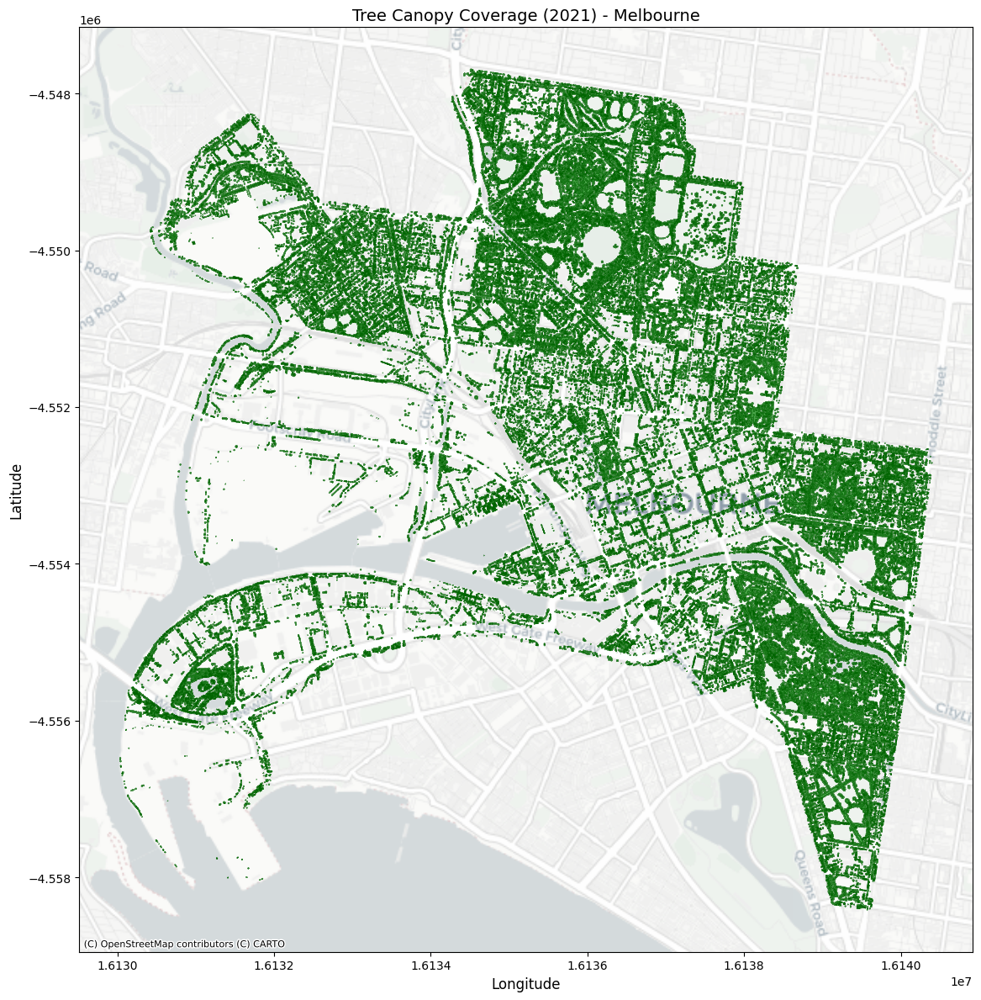

In [31]:
# Convert Tree Canopies dataset into a GeoDataFrame if not already done
if 'geometry' not in df_tree_canopy_2021.columns:
    df_tree_canopy_2021['geometry'] = df_tree_canopy_2021['geo_shape'].apply(lambda x: shape(json.loads(x)))

# Create GeoDataFrame
gdf = gpd.GeoDataFrame(df_tree_canopy_2021, geometry='geometry', crs='EPSG:4326')

# Project to Web Mercator for compatibility with contextily basemaps
gdf_projected = gdf.to_crs(epsg=3857)

# Create the plot
fig, ax = plt.subplots(figsize=(14, 12))

# Plot tree canopy data
gdf_projected.plot(ax=ax, color='green', edgecolor='darkgreen', alpha=0.7, 
                  label='Tree Canopies')

# Add the contextily basemap
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron)

# Add title and labels
ax.set_title('Tree Canopy Coverage (2021) - Melbourne', fontsize=14)
ax.set_xlabel("Longitude", fontsize=12)
ax.set_ylabel("Latitude", fontsize=12)

# Improve readability
plt.tight_layout()

# Show the plot
plt.show()

The chart shows a dense distribution of tree canopies in specific parts of the region, highlighted in green. These visualisations are required for identifying areas that already have substantial green coverage and pinpointing regions that require further intervention to enhance urban greenery. This analysis supports strategic planning for biodiversity conservation, reduction of urban heat islands, and improving the quality of public spaces.

In the below visualisation, segmenting the geographic area into a grid by binning both `latitude` and `longitude` values, then counting how many tree canopy points fall into each grid cell. These counts are visualised as a 2D heatmap, where darker green shades represent higher tree canopy density across Melbourne.

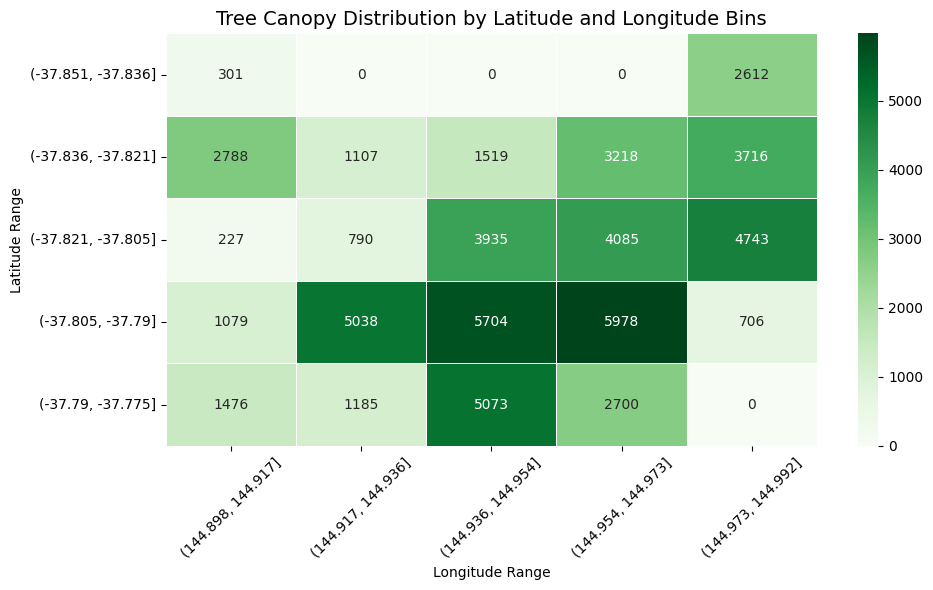

In [32]:
# Bin both longitude and latitude
df_tree_canopy_2021['longitude_bins'] = pd.cut(df_tree_canopy_2021['longitude'], bins=5)
df_tree_canopy_2021['latitude_bins'] = pd.cut(df_tree_canopy_2021['latitude'], bins=5)

# Group by both bins
lat_lon_counts = df_tree_canopy_2021.groupby(['latitude_bins', 'longitude_bins']).size().unstack(fill_value=0)

# Plot heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(lat_lon_counts, cmap='Greens', annot=True, fmt='d', linewidths=0.5)
plt.title("Tree Canopy Distribution by Latitude and Longitude Bins", fontsize=14)
plt.xlabel("Longitude Range")
plt.ylabel("Latitude Range")
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

The heatmap highlights distinct spatial variations in tree canopy cover across Melbourne. Below are some observations:

- Central and southeast grid cells show the highest canopy densities, indicating robust vegetation corridors in those areas.  
- In contrast, the northwest quadrant and outermost cells have very low counts, revealing pockets with sparse or nearly absent tree cover.  

These insights provides a view of canopy density in different pockets of the city.

**Microclimate Sensor dataset**

The figure shows each sensor’s position with a 50 m buffer around it. Next, we will assess how the tree canopy within these 50 m zones influences local pollution levels.

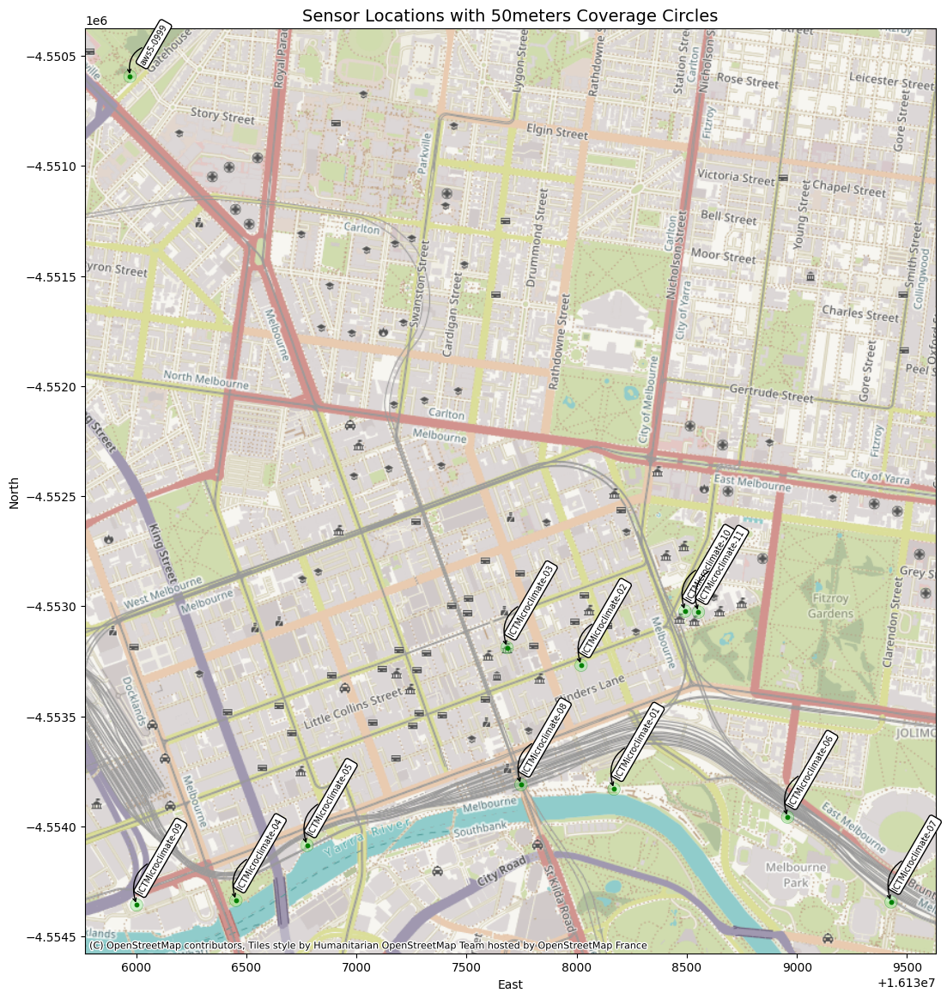

In [33]:
#setting up the radius for the coverage circles
radius = 50 # coverage in meters
r = math.sqrt((radius * radius)/math.pi)

# preparing sensor data
device_locations = (
    df_microclimate
    .groupby('device_id')[['latitude', 'longitude']]
    .first()
    .reset_index()
)

# creating GeoDataFrame
gdf_sensors = gpd.GeoDataFrame(
    device_locations,
    geometry=gpd.points_from_xy(device_locations['longitude'], device_locations['latitude']),
    crs="EPSG:4326"  # lat/lon
)

# projecting to Web Mercator (meters, good for maps)
gdf_sensors = gdf_sensors.to_crs(epsg=3857)

# creating the buffered circles
gdf_sensors['buffered_geometry'] = gdf_sensors.geometry.buffer(r)

# initializing the plot
fig, ax = plt.subplots(figsize=(14, 14))

# plotting circles
gdf_sensors.set_geometry('buffered_geometry').plot(ax=ax, alpha=0.4, edgecolor='green', color='lightgreen',
                                                  linewidth=0.5, label='Coverage Circles')

# sensor points
gdf_sensors.set_geometry('geometry').plot(ax=ax, color='green', markersize=10)

# add labels at point locations
for _, row in gdf_sensors.iterrows():
    ax.annotate(
        row['device_id'],
        xy=(row.geometry.x, row.geometry.y),
        xytext=(20, 10),
        textcoords='offset points',
        ha='center',
        #va='center',
        fontsize=7,
        rotation=60,
        bbox=dict(boxstyle='round,pad=0.3', edgecolor='black', facecolor='white'),
        arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.5'),
        color='black'
    )
# adding a real basemap
ctx.add_basemap(ax, crs=gdf_sensors.crs.to_string())

# setting the title and labels
ax.set_title(f"Sensor Locations with {radius}meters Coverage Circles", fontsize=14)
ax.set_xlabel("East")
ax.set_ylabel("North")

plt.show()

The box-and-whisker format helps identify both the typical range (the box) and the more extreme daily averages (the whiskers and any outliers). The taller boxes or higher medians tend to have more elevated PM2.5 levels or wider day-to-day fluctuations. The spread of the boxes reveals how stable or variable temperatures are on a daily basis, and outliers may point to unusual temperature spikes or dips on specific days.

In [34]:

# Create a 'month' column
df_microclimate['month'] = df_microclimate['received_at'].dt.to_period('M').astype(str)

# Group by month and device to calculate the average PM2.5 * Air Temperature
avg_pm25 = df_microclimate.groupby(['month', 'device_id'])['pm25'].mean().reset_index()

# Create a box plot: x-axis as month, y-axis as average PM2.5
fig1 = px.box(avg_pm25, 
              x='month', 
              y='pm25', 
              title="Distribution of Average PM2.5 per Month Across Devices",
              labels={"pm25": "Average PM2.5", "month": "Month"})
fig1.show()


**Distribution of Average PM2.5 per Month Across Devices:**

The box plot displays the distribution of average PM2.5 levels across different months for all devices. It highlights the central tendency and variability in pollution levels, clearly showing which months record higher or lower PM2.5 concentrations. Observations from this plot reveal that the months from December to March, likely influenced by the summer season, exhibit a higher median PM2.5. Additionally, the plot shows noticeable outliers, indicating that on certain days, there are unexpected spikes in pollution levels. These variations could be due to transient local events or differences in microclimate conditions across sensor locations.

-------------------------------------
Building upon the previous analysis, we narrow our focus to January—the month with the highest PM2.5 levels. The dataset is filtered to include only January's records, and a new date column is created to group data by each day. For every device, daily averages for PM2.5 is computed, providing a more granular view of environmental conditions. This detailed approach reveals short-term fluctuations and local effects that might be obscured in broader monthly averages, offering deeper insights for targeted urban and pollution management strategies. Additionally, the analysis aims to observe the variance across all devices to determine whether the differences in daily averages are consistent or if certain locations exhibit significantly different patterns.

In [35]:
# Filter for January data
january_data = df_microclimate[df_microclimate['received_at'].dt.month == 1].copy()

# Create a 'date' column (year-month-day) for grouping
january_data['date'] = january_data['received_at'].dt.date

# Group by device and date to calculate the daily average PM2.5
daily_avg_pm25 = january_data.groupby(['device_id', 'date'])['pm25'].mean().reset_index()
daily_avg_air_temp = january_data.groupby(['device_id', 'date'])['airtemperature'].mean().reset_index()

# Create a box plot: x-axis as device_id, y-axis as the daily average PM2.5
fig1 = px.box(daily_avg_pm25, 
             x='device_id', 
             y='pm25', 
             title="Average PM2.5 in January Across Devices",
             labels={"device_id": "Device ID", "pm25": "Daily Average PM2.5"})

fig1.show()

**Average PM2.5 in January Across Devices:**

This box plot clearly indicates that PM2.5 readings vary significantly among devices. Some devices consistently record higher median pollution levels with minimal variability, while others show wider ranges and occasional spikes. This suggests that certain locations are more prone to higher pollution levels, likely due to local factors that contribute to uneven distribution. Overall, the box plot offers detailed insights into daily environmental conditions across devices in January, highlighting the differences that are critical for targeted urban and pollution management strategies.

--------------------------------

**Tree Planting Zone dataset**

The following analysis examines tree planting data through a visual summary that highlights the distribution of segment or zone counts across different project schedules. The data is grouped by project timeframes to provide clear insights into how many segments or zones are at each stage. Custom ordering of the `schedule` column enhances readability and ensures the visualisation delivers more meaningful insights.

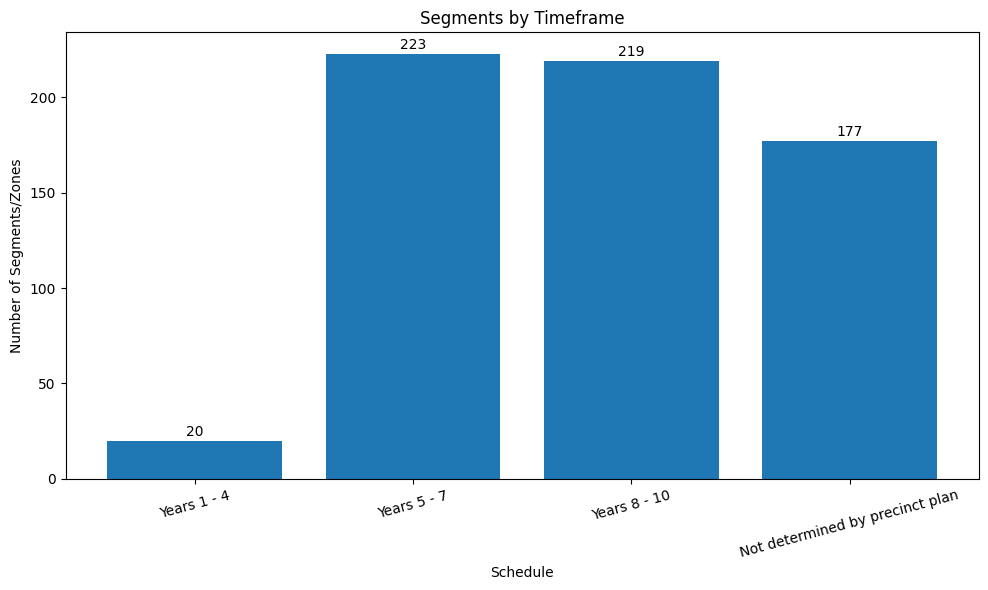

In [36]:
# group by schedule and count the number of segid
grouped = df_tree_planting.groupby('schedule')['segid'].count().reset_index()
custom_order = ['Complete', 'Years 1 - 4', 'Years 5 - 7', 'Years 8 - 10', 'Not determined by precinct plan']
grouped['schedule'] = pd.Categorical(grouped['schedule'], categories=custom_order, ordered=True)
grouped.sort_values('schedule', inplace=True)

# plot with annotations
plt.figure(figsize=(10, 6))
bars = plt.bar(grouped['schedule'], grouped['segid'])

# add totals on top
for bar in bars:
    height = bar.get_height()
    plt.text(
        bar.get_x() + bar.get_width() / 2,  # x-position: centre of bar
        height + 1,                         # y-position: just above bar
        f'{int(height)}',                   # label
        ha='center',
        va='bottom'
    )

plt.xlabel('Schedule')
plt.ylabel('Number of Segments/Zones')
plt.title('Segments by Timeframe')
plt.xticks(rotation=15)
plt.tight_layout()
plt.show()

From the chart, we can observe that the tree planting initiatives are at different stages across the zones. Approximately one-quarter of the zones have already completed their tree planting, indicating significant progress in these areas. The dataset reveals that the most intensive planting activity is planned for Years 5-7, which is the peak period for upcoming projects. This is followed by a substantial number of projects scheduled for Years 8-10, reflecting medium-to-long term plans. In contrast, the early-stage schedule (Years 1-4) shows the least activity, suggesting that immediate planting efforts are relatively fewer. Additionally, less than a quarter of the zones have an undetermined timeframe for planting, pointing to some uncertainty or pending decisions in these areas.

--------------------------------
The below visualisation combines spatial data—the locations of planting zones—with project schedule details to offer a comprehensive, bird’s-eye view of tree planting across Melbourne. It clearly shows how different zones are progressing, whether they are complete or planned for future periods.

The process begins by verifying that essential location details (longitude and latitude) are available, as these are crucial for accurately plotting the zones on a map. Once confirmed, the data is transformed to align with Melbourne’s mapping system, ensuring each planting zone appears in its correct location. The zones are then colour-coded based on their project schedule, enabling quick visual differentiation of their progress. Finally, a background map of Melbourne is added, providing familiar context and making it easier to understand the spatial distribution and planning of the tree planting projects.


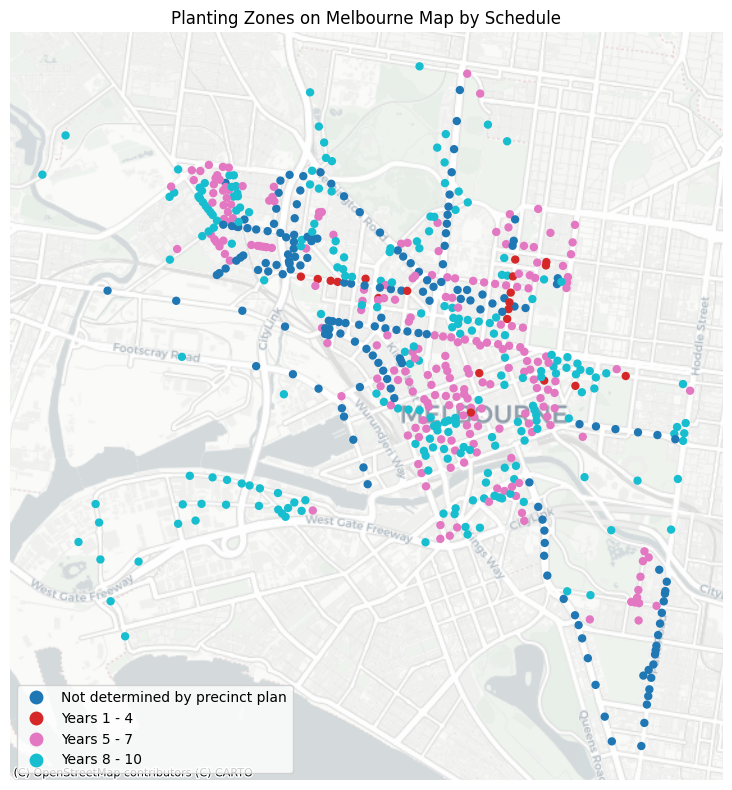

In [37]:
# replace 'longitude' and 'latitude' with the actual column names if different
if 'longitude' in df_tree_planting.columns and 'latitude' in df_tree_planting.columns:
    gdf = gpd.GeoDataFrame(
        df_tree_planting, geometry=gpd.points_from_xy(df_tree_planting.longitude, df_tree_planting.latitude),
        crs="EPSG:4326"
    )
else:
    raise ValueError("The dataset must contain 'longitude' and 'latitude' columns.")

# Convert GeoDataFrame to Web Mercator (EPSG:3857) for compatibility with basemaps
gdf = gdf.to_crs(epsg=3857)

# Plotting the GeoDataFrame, colour coding by 'schedule'
fig, ax = plt.subplots(figsize=(12, 8))
gdf.plot(ax=ax, column='schedule', categorical=True, legend=True, markersize=25, legend_kwds={'loc': 'lower left'})

# Add a basemap (using Stamen Toner Lite tiles)
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron)

# Set title and remove axis for a cleaner look
ax.set_title('Planting Zones on Melbourne Map by Schedule')
ax.set_axis_off()

plt.tight_layout()
plt.show()

## Data Preparation and Feature Selection

In this phase, we merge our cleaned microclimate sensor readings with concurrent pollution, temperature and humidity series from the Open Meteo API, then calculate the net PM2.5 reduction. We remove outliers via the IQR method to improve model robustness.

Next, we enrich each sensor record with a geospatial feature: the total tree-canopy area within a 50 m radius, obtained by buffering sensor locations and summing intersecting canopy geometries. We apply the same extraction process to the tree-planting zones, pulling meteorological data for their coordinates over the identical time span.

Finally, we assemble all relevant variables into a single dataset for regression modelling of the PM2.5 reduction achievable through targeted tree planting.

**Preprocessing for Microclimate dataset**

The below code maps PM2.5 and temperature values from df_air, df_temp and df_rhum to df_microclimate based on `received_at` & `date`, adds them as new columns. It also checks for null values after merging.

In [38]:
def merge_om_data (target_df, target_match_col, target_new_col, lkp_df, lkp_match_col, lkp_new_col):
    """
    Merges two DataFrames based on a common column and adds the new column.

    Parameters:
    - target_df (pd.DataFrame): The DataFrame to be updated.
    - target_match_col (str): The column in target_df to match with lkp_df.
    - target_new_col (str): The new column name in target_df.
    - lkp_df (pd.DataFrame): The DataFrame to merge from.
    - lkp_match_col (str): The column in lkp_df to match with target_df.
    - lkp_new_col (str): The column in lkp_df to be added to target_df.

    Returns:
    - pd.DataFrame: The updated DataFrame with the new column.
    """
    target_df_w = target_df.copy()
    #print(target_df[target_match_col].dtype)
    if lkp_df[lkp_match_col].dtype != 'datetime64[ns]':
        lkp_df[lkp_match_col] = pd.to_datetime(lkp_df[lkp_match_col])
    if target_df_w[target_match_col].dtype != 'datetime64[ns]':
        target_df_w[target_match_col] = pd.to_datetime(target_df_w[target_match_col])

    datetime_to_om = dict(zip(lkp_df[lkp_match_col], lkp_df[lkp_new_col]))
    target_df_w[target_new_col] = target_df_w[target_match_col].map(datetime_to_om)
    # Check for nulls in the new column
    print(f"Null values after merging in {target_new_col}:", target_df_w[target_new_col].isnull().sum())


    return target_df_w

In [ ]:
# merging data from Open Meteo API into the microclimate dataset
df_microclimate = merge_om_data(df_microclimate, 'received_at', 'pm_25_om', df_air, 'date', 'pm2_5')
df_microclimate = merge_om_data(df_microclimate, 'received_at', 'temp_2m_om', df_temp, 'date', 'temperature_2m')
df_microclimate = merge_om_data(df_microclimate, 'received_at', 'r_hum_om', df_rhum, 'date', 'relative_humidity_2m')
# printing the columns of the final dataset
print("\nDataset Columns:\n", df_microclimate.columns) 
print()

Null values after merging in pm_25_om: 0
Null values after merging in temp_2m_om: 1120
Null values after merging in r_hum_om: 1120

Final Dataset Columns:
 Index(['device_id', 'received_at', 'sensorlocation', 'airtemperature',
       'relativehumidity', 'pm25', 'latitude', 'longitude', 'month',
       'pm_25_om', 'temp_2m_om', 'r_hum_om'],
      dtype='object')



The below code computes the pm2.5 reduction using `pm25` and `pm_25_om` columns

In [40]:
# Calculate the variance between Open Meteo PM2.5 and sensor PM2.5
df_microclimate['pm25_red'] = df_microclimate['pm_25_om'] - df_microclimate['pm25']

# Display first few rows to verify the calculation
print("First few rows with PM2.5 Reduction:")
print(df_microclimate[['pm25', 'pm_25_om', 'pm25_red']].head())


First few rows with PM2.5 Reduction:
       pm25  pm_25_om  pm25_red
93241   1.0      12.6      11.6
26101   0.0      12.9      12.9
42960   2.0      12.9      10.9
42972   8.0      12.9       4.9
93244   1.0      12.9      11.9


**Removing Outliers from PM2.5 Reduction** 

This cell uses the IQR method to detect and drop extreme values in the `pm25_red` column, printing how many outliers were removed and updating `df_microclimate` to ensure a more robust dataset.

In [41]:
# Function to detect and remove outliers using IQR method
def remove_outliers(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    
    # Count outliers
    outliers = df[(df[column] < lower_bound) | (df[column] > upper_bound)]
    num_outliers = len(outliers)
    percent_outliers = (num_outliers / len(df)) * 100
    
    print(f"{column} - Removed {num_outliers} outliers ({percent_outliers:.2f}% of data)")
    print(f"  Range kept: {lower_bound:.2f} to {upper_bound:.2f}")
    
    # Return DataFrame with outliers removed
    return df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]

# Store original row count
original_count = len(df_microclimate)
print(f"Original DataFrame: {original_count} rows")

# Remove outliers from each column one by one
df_clean = df_microclimate.copy()
df_clean = remove_outliers(df_clean, 'pm25_red')

# Report final statistics
final_count = len(df_clean)
print(f"\nFinal DataFrame: {final_count} rows")
print(f"Total rows removed: {original_count - final_count} ({((original_count - final_count) / original_count) * 100:.2f}% of original data)")

# Reassign to df_microclimate if you want to update the original
df_microclimate = df_clean

Original DataFrame: 334847 rows
pm25_red - Removed 28067 outliers (8.38% of data)
  Range kept: -11.90 to 24.90

Final DataFrame: 306780 rows
Total rows removed: 28067 (8.38% of original data)


**Locating Tree Canopies with in 50 m Radius**

This function uses the Haversine formula to compute the great-circle distance between two latitude/longitude coordinates in metres. By converting geodetic distances into metric units, it lets us efficiently filter and select all tree-canopy features located within a 50 m radius of each sensor.

In [42]:
def find_distance_between_points(lat1, lon1, lat2, lon2):
    """
    Calculate the distance between two geographical points using the Haversine formula.
    
    Parameters:
    - lat1, lon1: Latitude and Longitude of the first point
    - lat2, lon2: Latitude and Longitude of the second point
    
    Returns:
    - Distance in meters
    """
    return round(geodesic((lat1, lon1), (lat2, lon2)).meters, 3)

In [43]:
#setting the coverage radius from device for tree canopy
coverage_radius = 50  # in m
coverage_area = math.pi * (coverage_radius ** 2)  # in m²

# Get unique combinations of device_id, latitude, and longitude
unique_locations = df_microclimate[['device_id', 'latitude', 'longitude']].drop_duplicates().reset_index(drop=True)
device_tree_matches = []
# Now iterate through these unique combinations
for idx, row in unique_locations.iterrows():
    device_id = row['device_id']
    orig_lat = row['latitude']
    orig_lon = row['longitude']
    t=0
    for jdx, rowj in df_tree_canopy_2021.iterrows():
        tree_lat = rowj['latitude']
        tree_lon = rowj['longitude']
        distance = find_distance_between_points(orig_lat, orig_lon, tree_lat, tree_lon)
        if distance < coverage_radius:
            t = t + 1
            # Store match in our list
            device_tree_matches.append({
            'device_id': device_id,
            'tree_lat': tree_lat,
            'tree_lon': tree_lon,
            'geo_shape': rowj['geo_shape'],
            'distance': distance
            })
    
    print(f"Device {device_id} has {t} trees within {coverage_radius} m of trees")
                  
# Create DataFrame from the list of matching pairs
df_device_trees = pd.DataFrame(device_tree_matches)

# Display basic info about the result
if len(df_device_trees) > 0:
    print(f"Found {len(df_device_trees)} trees within {coverage_radius} m of devices")
else:
    print(f"No trees found within {coverage_radius} m of any device")



Device ICTMicroclimate-01 has 23 trees within 50 m of trees
Device ICTMicroclimate-02 has 11 trees within 50 m of trees
Device ICTMicroclimate-03 has 13 trees within 50 m of trees
Device ICTMicroclimate-04 has 5 trees within 50 m of trees
Device ICTMicroclimate-05 has 7 trees within 50 m of trees
Device ICTMicroclimate-06 has 3 trees within 50 m of trees
Device ICTMicroclimate-07 has 10 trees within 50 m of trees
Device ICTMicroclimate-08 has 3 trees within 50 m of trees
Device ICTMicroclimate-09 has 11 trees within 50 m of trees
Device ICTMicroclimate-10 has 26 trees within 50 m of trees
Device ICTMicroclimate-11 has 28 trees within 50 m of trees
Device aws5-0999 has 27 trees within 50 m of trees
Found 167 trees within 50 m of devices


**Computing the area of Tree canopies**

The below function computes the area of the canpopy using the `geo_shape`. 

In [46]:
def calculate_area_m2(geo_shape_str):
    """
    Calculate the area of a GeoJSON shape in square meters.
    Parameters:
    - geo_shape_str (str): A string representation of a GeoJSON shape.
    Returns:
    - float: Area in square meters, or None if an error occurs. 
    """
    try:
        # Parse the GeoJSON string into a dictionary
        geojson = json.loads(geo_shape_str)
        
        # Create a Shapely geometry object from the GeoJSON dict
        geometry = shape(geojson)
        
        # Initialise a GeoSeries with the geometry, set CRS to WGS84 (EPSG:4326)
        geoseries = gpd.GeoSeries([geometry], crs="EPSG:4326")
        
        # Reproject to GDA94 / MGA zone 55 (EPSG:28355) suitable for Melbourne
        projected = geoseries.to_crs("EPSG:28355")
        
        # Calculate and return the area in square metres
        area_m2 = projected.area.values[0]
        return area_m2
    except Exception as e:
        # Log the exception and return None if an error occurs
        print(f"Error calculating area: {e}")
        return None

Computing the tree area in sq. meters using the `geo_shape` and adding a new column `tree_area_m2` to `df_microclimate`

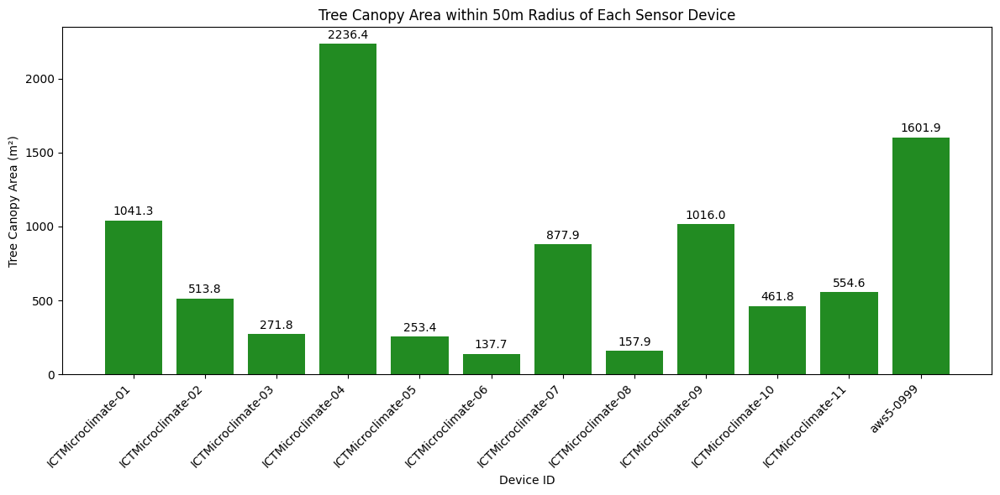

In [47]:
# Apply the function to create the new column
df_device_trees['tree_area_m2'] = df_device_trees['geo_shape'].apply(calculate_area_m2)

# Show the total tree area within the radius for each device
total_area_by_device = df_device_trees.groupby('device_id')['tree_area_m2'].sum().reset_index()

# Create a mapping dictionary from device_id to tree_area_m2
tree_area_map = dict(zip(total_area_by_device['device_id'], total_area_by_device['tree_area_m2']))

# Add the new column to df_microclimate
df_microclimate['tree_area_m2'] = df_microclimate['device_id'].map(tree_area_map)

# Create a bar chart for tree canopy area by device
plt.figure(figsize=(12, 6))
bars = plt.bar(total_area_by_device['device_id'], total_area_by_device['tree_area_m2'], color='forestgreen')

# Add labels and title
plt.xlabel('Device ID')
plt.ylabel('Tree Canopy Area (m²)')
plt.title('Tree Canopy Area within 50m Radius of Each Sensor Device')

# Add value labels on top of each bar
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height + 20,
            f'{height:.1f}',
            ha='center', va='bottom', rotation=0)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()

Extracting Month,  Day and Hour from `received_at` column. This is reqired for the regression model.

In [48]:
# Add month in year-month format (1-12)
df_microclimate['month'] = df_microclimate['received_at'].dt.month
# Get the day of the month (1-31)
df_microclimate['day'] = df_microclimate['received_at'].dt.day
# Get the hour of the day (0-23)
df_microclimate['hour'] = df_microclimate['received_at'].dt.hour

# Display the first few rows to verify the new columns
print(df_microclimate[['received_at', 'month', 'day', 'hour']].head())

                    received_at  month  day  hour
93241 2024-05-29 03:00:00+00:00      5   29     3
26101 2024-05-29 04:00:00+00:00      5   29     4
42960 2024-05-29 04:00:00+00:00      5   29     4
42972 2024-05-29 04:00:00+00:00      5   29     4
93244 2024-05-29 04:00:00+00:00      5   29     4


**Preprocessing for Tree Planting Zones dataset**

Continuing the preprocessing for `df_tree_planting` dataset. Computing the tree area in sq. meters using the `geo_shape` and adding a new column `tree_area_m2` to `df_tree_planting_preprocessed`

In [49]:
# Apply the calculate_area_m2 function to create a new tree_area_m2 column
df_tree_planting['tree_area_m2'] = df_tree_planting['geo_shape'].apply(calculate_area_m2)

# Display the first few rows to verify
print(df_tree_planting[['geo_shape', 'tree_area_m2']].head())

# Check for any null values in the new column
print(f"\nNull values in tree_area_m2: {df_tree_planting['tree_area_m2'].isna().sum()}")

                                           geo_shape  tree_area_m2
0  {"coordinates": [[[[144.969387175266, -37.8029...   3028.799632
1  {"coordinates": [[[[144.96828098035, -37.81969...    777.418201
2  {"coordinates": [[[[144.969341164027, -37.7965...    737.506563
3  {"coordinates": [[[[144.986101797552, -37.8163...   6103.824991
4  {"coordinates": [[[[144.97346041968, -37.80048...   1542.773898

Null values in tree_area_m2: 0


Merging PM2.5, Temperature and Relative Humidity data from Open Meteo API based on the coordinates for the tree planting zone. The duration of the data is identical to that of `df_microclimate` dataset. 

Renaming the chosen feature column names to match `df_microclimate`.

Extracting Month,  Day and Hour from `date` column. This is reqired for the regression model.

In [ ]:
# Container for each location’s data
all_dfs = []

# Iterate through each tree-planting location
for _, row in df_tree_planting.iterrows():
    lat, lon = row["latitude"], row["longitude"]
    segid = row["segid"]
    geo_shape = row["geo_shape"]
    schedule = row["schedule"]
    tree_area_m2 = row["tree_area_m2"]

    # 1. Fetch PM2.5
    df_pm25 = fetch_from_open_meteo(
        url        = air_quality_url,
        fetch_col  = "pm2_5",
        start_date = df_microclimate_min_date,
        end_date   = df_microclimate_max_date,
        latitude   = lat,
        longitude  = lon
    )
    
    # 2. Fetch temperature (2 m)
    df_temp = fetch_from_open_meteo(
        url        = temp_url,
        fetch_col  = "temperature_2m",
        start_date = df_microclimate_min_date,
        end_date   = df_microclimate_max_date,
        latitude   = lat,
        longitude  = lon
    )
    
    # 3. Fetch relative humidity (2 m)
    df_hum = fetch_from_open_meteo(
        url        = temp_url,
        fetch_col  = "relativehumidity_2m",
        start_date = df_microclimate_min_date,
        end_date   = df_microclimate_max_date,
        latitude   = lat,
        longitude  = lon
    )
    
    # 4. Merge on the timestamp
    df_loc = (
        df_pm25
        .merge(df_temp, on="date", how="inner")
        .merge(df_hum,  on="date", how="inner")
    )
    
    # 5. Annotate with the source location
    df_loc["latitude"]  = lat
    df_loc["longitude"] = lon
    df_loc["segid"]     = segid
    df_loc["geo_shape"] = geo_shape
    df_loc["schedule"]  = schedule
    df_loc["tree_area_m2"] = tree_area_m2

    all_dfs.append(df_loc)

# 6. Concatenate everything into one DataFrame
df_tree_planting_preprocessed = pd.concat(all_dfs, ignore_index=True)

# Rename columns to be consistent with microclimate dataset naming
df_tree_planting_preprocessed = df_tree_planting_preprocessed.rename(columns={
    'pm2_5': 'pm_25_om',
    'temperature_2m': 'temp_2m_om',
    'relativehumidity_2m': 'r_hum_om'
})

# Extract date components for consistency with microclimate dataset
df_tree_planting_preprocessed['month'] = df_tree_planting_preprocessed['date'].dt.month
df_tree_planting_preprocessed['day'] = df_tree_planting_preprocessed['date'].dt.day
df_tree_planting_preprocessed['hour'] = df_tree_planting_preprocessed['date'].dt.hour

# Display information about the resulting dataframe
print("Columns in processed tree planting dataset:", df_tree_planting_preprocessed.columns.tolist())
print("Sample data from the processed dataset:")
print(df_tree_planting_preprocessed.shape)
df_tree_planting_preprocessed.head()

Columns in processed tree planting dataset: ['date', 'pm_25_om', 'temp_2m_om', 'r_hum_om', 'latitude', 'longitude', 'segid', 'geo_shape', 'schedule', 'tree_area_m2', 'month', 'day', 'hour']
Sample data from the processed dataset:
(5374629, 13)


,date,pm_25_om,temp_2m_om,r_hum_om,latitude,longitude,segid,geo_shape,schedule,tree_area_m2,month,day,hour
0,2024-05-28 14:00:00+00:00,6.5,9.4525,79.055542,-37.803061,144.968795,21556,"{""coordinates"": [[[[144.969387175266, -37.8029...",Not determined by precinct plan,3028.799632,5,28,14
1,2024-05-28 15:00:00+00:00,5.9,9.6525,78.541473,-37.803061,144.968795,21556,"{""coordinates"": [[[[144.969387175266, -37.8029...",Not determined by precinct plan,3028.799632,5,28,15
2,2024-05-28 16:00:00+00:00,5.5,9.8025,76.688904,-37.803061,144.968795,21556,"{""coordinates"": [[[[144.969387175266, -37.8029...",Not determined by precinct plan,3028.799632,5,28,16
3,2024-05-28 17:00:00+00:00,5.2,9.6525,76.135620,-37.803061,144.968795,21556,"{""coordinates"": [[[[144.969387175266, -37.8029...",Not determined by precinct plan,3028.799632,5,28,17
4,2024-05-28 18:00:00+00:00,5.1,9.6525,73.283745,-37.803061,144.968795,21556,"{""coordinates"": [[[[144.969387175266, -37.8029...",Not determined by precinct plan,3028.799632,5,28,18


**Finalising the Feature Columns**

Following preprocessing, we select the feature columns used to train the regression model and generate predictions.

In [79]:
#setting training and testing datasets
train_df = df_microclimate.copy()
test_df = df_tree_planting_preprocessed.copy()

feature_cols = ['day', 'month', 'hour', 'pm_25_om','temp_2m_om', 'r_hum_om', 'tree_area_m2']
target_col = 'pm25_red'

## Building a Regression Model

**Finding Optimal Algorithm**

Determining the optimal model by comparing cross-validated performance metrics—such as RMSE and R²—across our candidates and selecting the top performer. Both RandomForest and XGBoost are ensemble tree-based algorithms: RandomForest builds multiple decision trees in parallel via bagging to reduce variance, while XGBoost constructs them sequentially using gradient boosting to correct errors and optimise accuracy.

The below function performs sensor-based GroupKFold cross-validation to generate unbiased train/test splits and support robust hyperparameter tuning.

In [52]:
def group_kfold_by_sensor(X, y, sensor_ids, n_splits=5):
    """
    Implement GroupKFold cross-validation where data from the same sensor
    stays together in either the training or test set.
    
    Parameters:
    -----------
    X : array-like
        Features or input data.
    y : array-like
        Target variable.
    sensor_ids : array-like
        Sensor IDs to use for grouping (e.g., device_id).
    n_splits : int, default=5
        Number of folds.
        
    Returns:
    --------
    fold_indices : list of tuples
        List containing (train_idx, test_idx) for each fold.
    """
    # Initialise GroupKFold
    group_kfold = GroupKFold(n_splits=n_splits)
    
    # Generate indices for each split
    fold_indices = list(group_kfold.split(X, y, groups=sensor_ids))
    
    return fold_indices

Setting up the training and testing datasets. Also preparing the feature set by one-hot encoding the `month` variable and generates sensor-grouped cross-validation folds for unbiased model evaluation.

In [66]:
#setting up the training dataset and categorical variables

X = train_df[feature_cols]
y = train_df[target_col]
X_processed = X.copy()

'''
# One-hot encode the 'month' categorical variable
encoder = OneHotEncoder(sparse_output=False, drop='first')
month_encoded = encoder.fit_transform(X.loc[X.index, ['month']].values.reshape(-1, 1))
month_cols = [f'month_{cat}' for cat in encoder.categories_[0][1:]]

# Add the encoded columns to X_processed
X_processed = X_processed.drop('month', axis=1)
for i, col in enumerate(month_cols):
    X_processed[col] = month_encoded[:, i]
'''
# Set up cross-validation using the group k-fold function
n_splits = 5
#device_ids = train_df['device_id']
device_ids = train_df['device_id'].loc[X.index]
folds = group_kfold_by_sensor(X_processed, y, device_ids, n_splits=n_splits)

Performing randomised hyperparameter tuning of a RandomForestRegressor using sensor-based GroupKFold cross-validation to optimise the R² score.

In [67]:
# Define parameter distribution
param_dist = {
    'n_estimators': [300, 500, 800, 1000, 1200],
    'max_depth': [10, 12, 14, 16, None],
    'min_samples_split': [2, 5, 10, 15],
    'min_samples_leaf': [1, 2, 4, 8],
    'max_features': ['sqrt', 'log2', 0.5, 0.7],
    'bootstrap': [True, False]
}

# Create base model
rf_base = RandomForestRegressor(oob_score=True, n_jobs=-1, random_state=27)

# Setup RandomizedSearchCV with your custom CV strategy
rf_random = RandomizedSearchCV(
    estimator=rf_base,
    param_distributions=param_dist,
    n_iter=20,  # Number of parameter settings to try
    cv=group_kfold_by_sensor(X_processed, y, device_ids, n_splits=5),
    #verbose=2,
    random_state=27,
    n_jobs=-1,
    scoring='r2'
)

# Fit RandomizedSearchCV
rf_random.fit(X_processed, y)

best_rf = RandomForestRegressor(
    **rf_random.best_params_,
    random_state=42
)

# Get best parameters and best score
print(f"Best parameters: {rf_random.best_params_}")
print(f"Best R² score: {rf_random.best_score_:.4f}")

Best parameters: {'n_estimators': 1000, 'min_samples_split': 2, 'min_samples_leaf': 8, 'max_features': 'sqrt', 'max_depth': 14, 'bootstrap': True}
Best R² score: 0.5709


Performing randomised hyperparameter optimisation of an XGBRegressor via sensor-based GroupKFold cross-validation to maximise the R² score.

In [68]:
# Define parameter grid for XGBoost
param_grid = {
    'n_estimators': [100, 300, 500, 700, 1000, 1200, 1500],
    'learning_rate': [0.001, 0.01, 0.05, 0.1, 0.2],
    'max_depth': [3, 5, 7, 9, 11, 13, 15],
    'min_child_weight': [1, 3, 5, 7, 9 , 11],
    'gamma': [0, 0.1, 0.2, 0.3, 0.4],
    'subsample': [0.6, 0.7, 0.8, 0.9, 1.0],
    'colsample_bytree': [0.6, 0.7, 0.8, 0.9, 1.0],
    'reg_alpha': [0, 0.1, 0.5, 1, 10],
    'reg_lambda': [0, 0.1, 1, 5, 10]
}

# Set up cross-validation using the group k-fold function
n_splits = 5

# Initialise XGBoost model
xgb_base = XGBRegressor(random_state=27, n_jobs=-1)

# Set up RandomizedSearchCV with GroupKFold
xgb_random = RandomizedSearchCV(
    estimator=xgb_base,
    param_distributions=param_grid,
    n_iter=30,  # Number of parameter settings to try
    cv=group_kfold_by_sensor(X_processed, y, device_ids, n_splits=n_splits),
    #verbose=1,
    random_state=42,
    n_jobs=-1,
    scoring='r2'
)

# Fit the RandomizedSearchCV
print("Starting hyperparameter search...")
xgb_random.fit(X_processed, y)

# Get best parameters and best score
print(f"\nBest parameters found: {xgb_random.best_params_}")
print(f"Best R² score: {xgb_random.best_score_:.4f}")

best_xgb = XGBRegressor(
    **xgb_random.best_params_,
    random_state=42
)

Starting hyperparameter search...

Best parameters found: {'subsample': 0.9, 'reg_lambda': 5, 'reg_alpha': 10, 'n_estimators': 1200, 'min_child_weight': 9, 'max_depth': 9, 'learning_rate': 0.01, 'gamma': 0.4, 'colsample_bytree': 0.6}
Best R² score: 0.5711


The below code trains the tuned RF and XGB models on each GroupKFold split, then blends their predictions with RF weights from 0.0 to 1.0.
Averages MSE and R² across folds for each weight to evaluate performance.
Selects the weight with the highest test R² as the optimal blend ratio.
Plots average R² against RF weight to visualise performance trade-offs.

Fold 1/5
  Completed testing 11 different weights for this fold
Fold 2/5
  Completed testing 11 different weights for this fold
Fold 3/5
  Completed testing 11 different weights for this fold
Fold 4/5
  Completed testing 11 different weights for this fold
Fold 5/5
  Completed testing 11 different weights for this fold

Best blending weight for Random Forest: 0.4
Best blending weight for XGBoost: 0.6
With this blend - Test MSE: 19.5558, Test R²: 0.5716


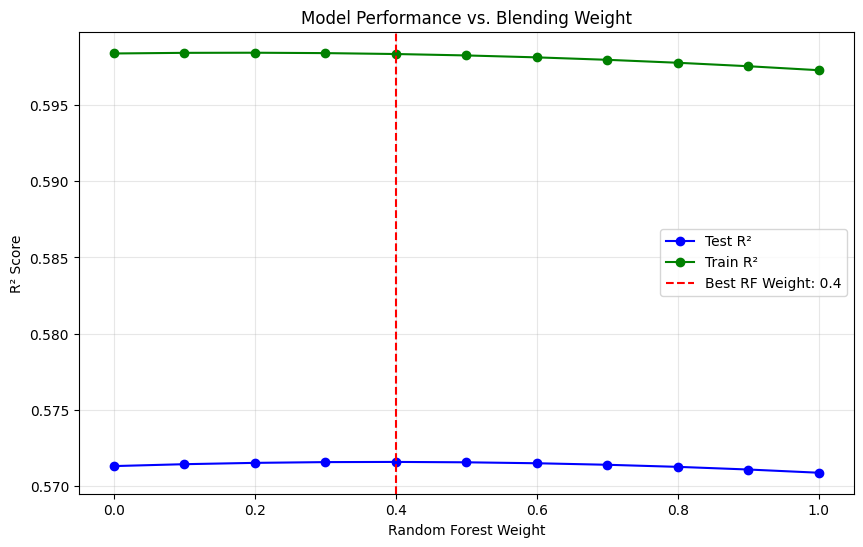

In [69]:

# Initialise models using the best parameters
rf = best_rf # RandomForestRegressor
xgb = best_xgb # XGBRegressor

# Initialise variables to track best blending weights
best_weight_rf = 0
best_test_r2 = 0
best_test_mse = float('inf')

# Test different weights for RF (XGB weight will be 1-RF weight)
weights_rf = [i/10 for i in range(11)]  # 0.0, 0.1, 0.2, ..., 1.0
fold_metrics = {weight: {'train_mse': [], 'test_mse': [], 
                         'train_r2': [], 'test_r2': []} 
               for weight in weights_rf}

# Loop through each fold
for i, (train_idx, test_idx) in enumerate(folds):
    print(f"Fold {i+1}/{n_splits}")
    X_train, X_test = X_processed.iloc[train_idx], X_processed.iloc[test_idx]
    y_train, y_test = y.iloc[train_idx], y.iloc[test_idx]
    
    # Train both models
    rf.fit(X_train, y_train)
    xgb.fit(X_train, y_train)
    
    # Get predictions from both models
    rf_pred_train = rf.predict(X_train)
    rf_pred_test = rf.predict(X_test)
    xgb_pred_train = xgb.predict(X_train)
    xgb_pred_test = xgb.predict(X_test)
    
    # Test different weights
    for weight_rf in weights_rf:
        # Calculate weight for XGB
        weight_xgb = 1.0 - weight_rf
        
        # Blend predictions
        y_pred_train = weight_rf * rf_pred_train + weight_xgb * xgb_pred_train
        y_pred_test = weight_rf * rf_pred_test + weight_xgb * xgb_pred_test
        
        # Calculate metrics
        train_mse = mean_squared_error(y_train, y_pred_train)
        test_mse = mean_squared_error(y_test, y_pred_test)
        train_r2 = r2_score(y_train, y_pred_train)
        test_r2 = r2_score(y_test, y_pred_test)
        
        # Store metrics for this weight
        fold_metrics[weight_rf]['train_mse'].append(train_mse)
        fold_metrics[weight_rf]['test_mse'].append(test_mse)
        fold_metrics[weight_rf]['train_r2'].append(train_r2)
        fold_metrics[weight_rf]['test_r2'].append(test_r2)
    
    # Print progress for this fold
    print(f"  Completed testing {len(weights_rf)} different weights for this fold")

# After all folds, calculate average metrics for each weight
avg_metrics = {}
for weight in weights_rf:
    avg_metrics[weight] = {
        'avg_train_mse': np.mean(fold_metrics[weight]['train_mse']),
        'avg_test_mse': np.mean(fold_metrics[weight]['test_mse']),
        'avg_train_r2': np.mean(fold_metrics[weight]['train_r2']),
        'avg_test_r2': np.mean(fold_metrics[weight]['test_r2'])
    }

# Find the best weight based on test R²
best_weight_rf = max(weights_rf, key=lambda w: avg_metrics[w]['avg_test_r2'])
best_test_r2 = avg_metrics[best_weight_rf]['avg_test_r2']
best_test_mse = avg_metrics[best_weight_rf]['avg_test_mse']

print(f"\nBest blending weight for Random Forest: {best_weight_rf}")
print(f"Best blending weight for XGBoost: {1.0 - best_weight_rf}")
print(f"With this blend - Test MSE: {best_test_mse:.4f}, Test R²: {best_test_r2:.4f}")

# Create a plot of weights vs performance
plt.figure(figsize=(10, 6))
plt.plot(weights_rf, [avg_metrics[w]['avg_test_r2'] for w in weights_rf], 'o-', 
         color='blue', label='Test R²')
plt.plot(weights_rf, [avg_metrics[w]['avg_train_r2'] for w in weights_rf], 'o-', 
         color='green', label='Train R²')
plt.axvline(x=best_weight_rf, color='red', linestyle='--', label=f'Best RF Weight: {best_weight_rf}')
plt.xlabel('Random Forest Weight')
plt.ylabel('R² Score')
plt.title('Model Performance vs. Blending Weight')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()

**Building the Regression Model**

The below code constructs median-imputation + model pipelines for RF and XGB, trains both on the full preprocessed data, blends their predictions with the optimal RF:XGB weight from the above step, and evaluates final MSE and R². It also saves the model into a file.

In [70]:
# Create pipelines for both models that include imputation
rf_pipeline = Pipeline([
    ('imputer', SimpleImputer(strategy='median')),
    ('model', best_rf)
])

xgb_pipeline = Pipeline([
    ('imputer', SimpleImputer(strategy='median')),
    ('model', best_xgb)
])

# Train both models
print("Training Random Forest model...")
rf_pipeline.fit(X_processed, y)

print("Training XGBoost model...")
xgb_pipeline.fit(X_processed, y)

# Make predictions with both models
rf_preds = rf_pipeline.predict(X_processed)
xgb_preds = xgb_pipeline.predict(X_processed)

# The best blending weight for RF (determined through cross-validation)
rf_weight = best_weight_rf
xgb_weight = 1 - best_weight_rf

# Create blended predictions
blended_preds = rf_weight * rf_preds + xgb_weight * xgb_preds

# Evaluate the combined model
mse = mean_squared_error(y, blended_preds)
r2 = r2_score(y, blended_preds)

print(f"Final Ensemble Model Performance:")
print(f"Mean Squared Error: {mse:.4f}")
print(f"R² Score: {r2:.4f}")

# Save the trained models and encoder
model_artifacts = {
    'rf_model': rf_pipeline,
    'xgb_model': xgb_pipeline,
    'feature_cols': feature_cols,
    'rf_weight': rf_weight,
    'xgb_weight': xgb_weight
}

# Save the model artifacts
joblib.dump(model_artifacts, 'tree_pm25_ensemble_model.joblib')

print("Model artifacts saved to 'tree_pm25_ensemble_model.joblib'")

Training Random Forest model...
Training XGBoost model...
Final Ensemble Model Performance:
Mean Squared Error: 18.4525
R² Score: 0.5960
Model artifacts saved to 'tree_pm25_ensemble_model.joblib'


Regressing the values of PM2.5 reduction on Tree Planting Zone Schedule datset using the model trained above

In [142]:
# Load the model artifacts saved earlier
model_artifacts = joblib.load('tree_pm25_ensemble_model.joblib')

# Extract model components
rf_pipeline = model_artifacts['rf_model']
xgb_pipeline = model_artifacts['xgb_model']
feature_cols = model_artifacts['feature_cols']
rf_weight = model_artifacts['rf_weight']
xgb_weight = model_artifacts['xgb_weight']

# Prepare the test data
X_test = test_df[feature_cols].copy()

# Make predictions with both models
rf_preds = rf_pipeline.predict(X_test)
xgb_preds = xgb_pipeline.predict(X_test)

# Combine predictions using the weights
predicted_pm25_red = rf_weight * rf_preds + xgb_weight * xgb_preds

# Display sample of predictions
print(f"Predicted PM2.5 reduction (first 5 samples):")
print(predicted_pm25_red[:5])
print(f"\nTotal number of predictions: {len(predicted_pm25_red)}")

# Add predictions to df_all
X_test['predicted_pm25_red'] = predicted_pm25_red

Predicted PM2.5 reduction (first 5 samples):
[2.95619719 2.51826046 2.22830683 1.87022022 1.74906941]

Total number of predictions: 5374629


Merging the predictions with the original test dataset `test_df`

In [143]:
# since X_test is a copy of test_df, we can add rest of the column directly from test_df to X_test.

# Add segid column to X_test from the source data frame
X_test['segid'] = test_df['segid']
X_test['schedule'] = test_df['schedule']
X_test['longitude'] = test_df['longitude']
X_test['latitude'] = test_df['latitude']
X_test['date'] = test_df['date']
X_test['geo_shape'] = test_df['geo_shape']

# Print the first few rows to verify the column was added
print(X_test.head())


   day  month  hour  pm_25_om  temp_2m_om   r_hum_om  tree_area_m2  \
0   28      5    14       6.5      9.4525  79.055542   3028.799632   
1   28      5    15       5.9      9.6525  78.541473   3028.799632   
2   28      5    16       5.5      9.8025  76.688904   3028.799632   
3   28      5    17       5.2      9.6525  76.135620   3028.799632   
4   28      5    18       5.1      9.6525  73.283745   3028.799632   

   predicted_pm25_red  segid                         schedule   longitude  \
0            2.956197  21556  Not determined by precinct plan  144.968795   
1            2.518260  21556  Not determined by precinct plan  144.968795   
2            2.228307  21556  Not determined by precinct plan  144.968795   
3            1.870220  21556  Not determined by precinct plan  144.968795   
4            1.749069  21556  Not determined by precinct plan  144.968795   

    latitude                      date  \
0 -37.803061 2024-05-28 14:00:00+00:00   
1 -37.803061 2024-05-28 15:00:00

Aggregating the predicted data by taking median of PM2.5 reduction value

In [144]:
# Define your grouping keys
group_keys = ['segid', 'schedule', 'longitude', 'latitude','geo_shape','tree_area_m2']

# Directly aggregate the data we need using groupby
df_pred_pm25_tree_planting = (
    X_test
    .groupby(group_keys)
    .agg({
        'predicted_pm25_red': 'median'
    })
    .reset_index()
)

# display the number of rows in the aggregated dataset
print(f"Number of rows aggregated dataset: {len(df_pred_pm25_tree_planting)}")

Number of rows aggregated dataset: 639


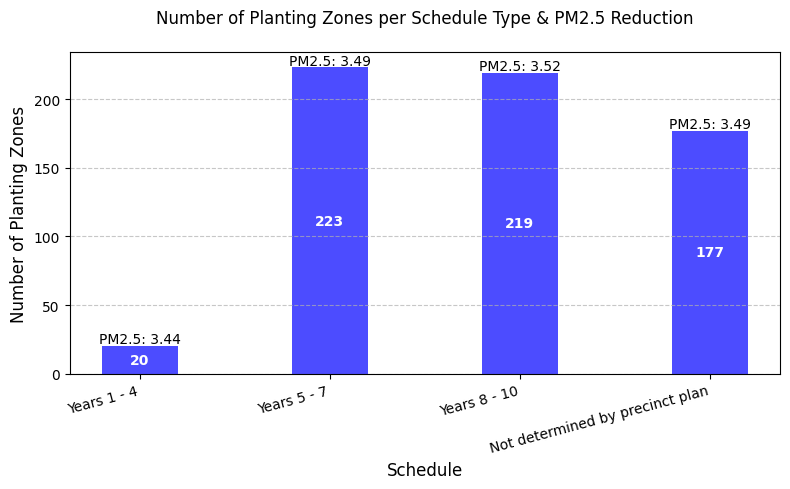

In [145]:
# Group by 'schedule' and calculate counts and median predicted_pm25_red
schedule_stats = df_pred_pm25_tree_planting.groupby('schedule').agg({
    'segid': 'count',  # Count the number of zones
    'predicted_pm25_red': 'max'  # Median PM2.5 reduction
}).reset_index()

# Define a custom order for the schedule categories
custom_order = ['Years 1 - 4', 'Years 5 - 7', 'Years 8 - 10', 'Not determined by precinct plan']

# Create a categorical type with the custom order
schedule_stats['schedule'] = pd.Categorical(schedule_stats['schedule'], categories=custom_order, ordered=True)
schedule_stats = schedule_stats.sort_values('schedule')

# Create the plot
plt.figure(figsize=(8, 5))
# Create a bar plot
bars = plt.bar(schedule_stats['schedule'], schedule_stats['segid'], width=0.4, color='blue', alpha=0.7)

# Add median labels above each bar
for bar, max in zip(bars, schedule_stats['predicted_pm25_red']):
    height = bar.get_height()
    plt.text(
        bar.get_x() + bar.get_width()/2, 
        height + 5,  
        f'PM2.5: {max:.2f}',
        ha='center', va='center', fontsize=10
    )

# Add count labels inside each bar
for bar in bars:
    height = bar.get_height()
    plt.text(
        bar.get_x() + bar.get_width()/2, 
        height/2,  
        f'{int(height)}',
        ha='center', va='center', color='white', fontweight='bold', fontsize=10
    )

# Customize the plot
plt.title('Number of Planting Zones per Schedule Type & PM2.5 Reduction\n', fontsize=12)
plt.xlabel('Schedule', fontsize=12)
plt.ylabel('Number of Planting Zones', fontsize=12)
plt.xticks(rotation=15, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()

plt.show()

**Tree Planting Zones by Schedule with PM25 Reduction Potential** 

This chart provides a dual perspective on Melbourne's tree planting zones, showing both the quantity of zones in each schedule period and their potential environmental impact through PM2.5 reduction values.

The data reveals that Years 5-7 contain the highest number of planting zones (223), closely followed by Years 8-10 (219). This indicates that the majority of tree planting is planned for medium-term implementation. A substantial number of zones (177) remain without a determined timeline in the precinct plan, while only a small number (20) are scheduled for immediate action in Years 1-4.

Interestingly, the Years 8-10 category shows the highest maximum PM2.5 reduction potential (3.52 μg/m³), suggesting that these longer-term planting zones may be strategically positioned in areas where they could have the greatest impact on air quality. The other schedule categories show similar but slightly lower PM2.5 reduction values, ranging from 3.44 to 3.49 μg/m³.

This visualisation effectively communicates both the temporal distribution of planned tree planting and the projected air quality improvements.

Labeling top 20 zones by PM2.5 reduction out of 639 total zones


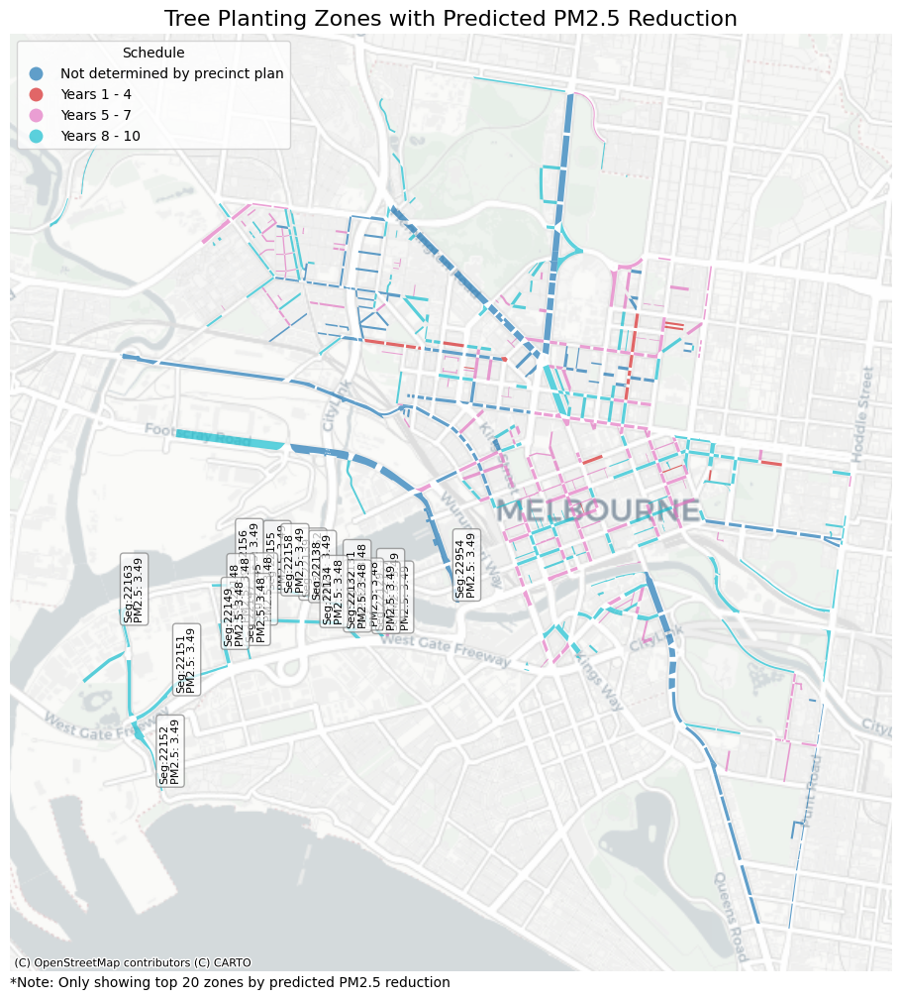

In [146]:
# Create a GeoDataFrame from agg_df with error handling for geometry parsing
geometries = []
valid_indices = []

for idx, geo_str in enumerate(df_pred_pm25_tree_planting['geo_shape']):
    try:
        geom = shape(json.loads(geo_str))
        geometries.append(geom)
        valid_indices.append(idx)
    except (json.JSONDecodeError, ValueError) as e:
        print(f"Error parsing geometry at index {idx}: {e}")
        continue

# Create GeoDataFrame with only valid geometries
gdf_tree_planting = gpd.GeoDataFrame(
    df_pred_pm25_tree_planting.iloc[valid_indices].copy(),
    geometry=geometries,
    crs="EPSG:4326"  # WGS84 coordinate system
)

# Convert to Web Mercator projection for basemap compatibility
gdf_tree_planting = gdf_tree_planting.to_crs(epsg=3857)

# Create figure and axes
fig, ax = plt.subplots(figsize=(12, 10))

# Plot the tree planting zones, color-coded by schedule
gdf_tree_planting.plot(
    column='schedule',
    categorical=True,
    legend=True,
    ax=ax,
    alpha=0.7,
    legend_kwds={'loc': 'upper left', 'title': 'Schedule'}
)

# Determine if there are too many zones to label clearly
max_labels = 50
if len(gdf_tree_planting) > max_labels:
    # Only label the top zones by PM2.5 reduction
    top_n = min(20, len(gdf_tree_planting))
    top_indices = gdf_tree_planting['predicted_pm25_red'].nlargest(top_n).index
    label_gdf = gdf_tree_planting.loc[top_indices]
    print(f"Labeling top {top_n} zones by PM2.5 reduction out of {len(gdf_tree_planting)} total zones")
else:
    label_gdf = gdf_tree_planting

# Add predicted PM2.5 reduction labels to selected zones
for idx, row in label_gdf.iterrows():
    # Get centroid of polygon for label placement
    centroid = row.geometry.centroid
    # Add label with segid and predicted PM2.5 reduction value
    ax.annotate(f"Seg:{row['segid']}\nPM2.5: {row['predicted_pm25_red']:.2f}", 
                xy=(centroid.x, centroid.y),
                #ha='top', va='top',
                fontsize=8,
                color='black',
                rotation=90,
                bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="gray", alpha=0.7))

# Add basemap
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron)

# Set title and style
ax.set_title('Tree Planting Zones with Predicted PM2.5 Reduction', fontsize=16)
ax.set_axis_off()

# Add note if not all zones are labeled
if len(gdf_tree_planting) > max_labels:
    plt.figtext(0.5, 0.01, f"*Note: Only showing top {top_n} zones by predicted PM2.5 reduction", 
                va='top',ha='right', fontsize=10)

plt.tight_layout()
plt.show()

**Tree Planting Zones with Predicted PM2.5 Reduction Potential**

The map visualises Melbourne's scheduled tree planting zones, color-coded by implementation schedule and labeled with their predicted air quality improvement potential. This spatial analysis reveals several important patterns:

**Observations**
- The zones with highest PM2.5 reduction potential (3.48-3.52 μg/m³) appear clustered in specific neighborhoods, particularly in the central and southern portions of the mapped area
- Different schedule categories appear somewhat clustered, suggesting a neighborhood-by-neighborhood implementation approach rather than dispersed planting
- Segments in the "Years 8-10" schedule frequently show the highest PM2.5 reduction potential, consistent with earlier findings
- The labeled segments (top 20 by PM2.5 reduction) reveal that areas with highest potential improvement have predicted reductions of 3.48-3.52 μg/m³
- Segment 22139 shows the highest predicted PM2.5 reduction at 3.52 μg/m³



## Observations and Conclusions

### Dataset Integration and Analysis
This project successfully integrated three complex spatial datasets to understand the relationship between urban tree coverage and air quality in Melbourne:

1. **Tree Canopies (2021)**: Mapped existing tree coverage across Melbourne, revealing dense vegetation in central and southeast areas with sparse coverage in northwestern quadrants.

2. **Microclimate Sensor Data**: Provided hyper-local measurements of PM2.5, temperature, and humidity across 12 sensors, showing significant seasonal variations with highest pollution levels in summer months (December-March).

3. **Tree Planting Zones**: Identified 639 planned planting areas across Melbourne with various implementation timeframes (Years 1-4, 5-7, 8-10, and undetermined zones).

4. **Open Meteo Historical Data**: Provided reliable baseline measurements of PM2.5, temperature, and relative humidity across Melbourne, enabling calculation of pollution reduction effects. By comparing sensor readings with city-wide values, I quantified the precise impact of tree canopy on local air quality, showing reductions of approximately 3.5 μg/m³ in particulate matter where canopy coverage is substantial.

### Key Findings

#### Spatial Patterns
- Sensors recorded widely varying PM2.5 levels depending on location, suggesting microclimate effects

- The existing tree canopy is unevenly distributed, creating opportunities for targeted planting

- Areas with higher tree canopy density within 50m of sensors showed measurable reductions in PM2.5 levels

#### PM2.5 Reduction Potential
- Our ensemble model predicts approximately 3.5 μg/m³ median PM2.5 reduction from tree planting

- Top-performing zones show potential reductions exceeding 4.1 μg/m³

- Zones scheduled for Years 8-10 show highest average reduction potential (3.52 μg/m³)

- Most beneficial planting locations appear clustered in specific neighborhoods

#### Implementation Timeline
- Trees typically begin providing initial PM2.5 reduction within 2-3 years of planting, with measurable significant improvements observed after 5-7 years as canopies develop. This timeline should be factored into planning.

- The majority of planting zones are scheduled for mid-term (Years 5-7: 223 zones) and long-term (Years 8-10: 219 zones) implementation

- Only 20 zones are scheduled for immediate action (Years 1-4)

- 177 zones remain without a determined implementation timeline which needs attention

### Modeling Approach
The blended ensemble of Random Forest and XGBoost models achieved an R² of approximately 0.6, demonstrating that local tree canopy area combined with meteorological variables explains a significant portion of PM2.5 variability, while leaving room for other environmental factors.

### Recommendations
- **Implementation Timeline**: Consider that newly planted trees require time to mature before delivering full air quality benefits.

- **Plan Undetermined Zones**: Establish concrete implementation schedules for the 177 zones currently lacking defined timelines. These represent nearly 28% of all planting zones and should be evaluated based on their potential PM2.5 reduction impact and integrated into the comprehensive urban forest strategy with clear target dates.

- **Prioritization**: Focus on zones with highest predicted PM2.5 reduction potential, particularly those in Years 5-10 timeframes

- **Strategic Planning**: Consider accelerating implementation in high-impact areas currently in Years 8-10

- **Adaptive Management**: Continue sensor monitoring and model refinement to optimize outcomes as trees mature and environmental conditions evolve, allowing for data-driven adjustments to planting strategies and maintenance routines based on real-world performance measurements

- **Further Research**: Explore additional variables that might explain the remaining variance in PM2.5 reduction

By implementing these recommendations, Melbourne's urban forest strategy can maximize air quality benefits while creating a more resilient, sustainable urban environment.